<a href="https://colab.research.google.com/github/djbetancourtr/djbetancourtr.github.io/blob/main/Credit_Card_Application_Unsupervised_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Credit Card Application Clustering Capstone

Context

Credit score cards are a common risk control method in the financial industry. It uses personal information and data submitted by credit card applicants to predict the probability of future defaults and credit card borrowings. The bank is able to decide whether to issue a credit card to the applicant. Credit scores can objectively quantify the magnitude of risk.
 
Generally speaking, credit score cards are based on historical data. Once encountering large economic fluctuations. Past models may lose their original predictive power. Logistic model is a common method for credit scoring. Because Logistic is suitable for binary classification tasks and can calculate the coefficients of each feature. In order to facilitate understanding and operation, the score card will multiply the logistic regression coefficient by a certain value (such as 100) and round it.

Task
Using unsupervised learning model and clustering techniques, build a machine learning model to cluster applicants and determine if they can be high risk when given a credit card. Ground truth is not available.

Dataset:
The dataset for this task can be found: https://www.kaggle.com/rikdifos/credit-card-approval-prediction

In [ ]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# importing libraries

import numpy as np
import pandas as pd
import scipy
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats.mstats import winsorize
import seaborn as sns
from scipy import stats
from sklearn import datasets, metrics
from matplotlib.patches import Ellipse
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
#import umap.umap_ as umap
import umap

In [ ]:
# reading and visualizing the dataset

application_data = pd.read_csv('/content/drive/My Drive/application_record.csv')
application_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438557 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438557 non-null  int64  
 1   CODE_GENDER          438557 non-null  object 
 2   FLAG_OWN_CAR         438557 non-null  object 
 3   FLAG_OWN_REALTY      438557 non-null  object 
 4   CNT_CHILDREN         438557 non-null  int64  
 5   AMT_INCOME_TOTAL     438557 non-null  float64
 6   NAME_INCOME_TYPE     438557 non-null  object 
 7   NAME_EDUCATION_TYPE  438557 non-null  object 
 8   NAME_FAMILY_STATUS   438557 non-null  object 
 9   NAME_HOUSING_TYPE    438557 non-null  object 
 10  DAYS_BIRTH           438557 non-null  int64  
 11  DAYS_EMPLOYED        438557 non-null  int64  
 12  FLAG_MOBIL           438557 non-null  int64  
 13  FLAG_WORK_PHONE      438557 non-null  int64  
 14  FLAG_PHONE           438557 non-null  int64  
 15  FLAG_EMAIL       

For application_data datset, looks like there is no missing values in the columns, except for "Occupation_Type" data. There is a total of 18 columns and 438557 input values.

In [ ]:
application_data

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
438552,6840104,M,N,Y,0,135000.0,Pensioner,Secondary / secondary special,Separated,House / apartment,-22717,365243,1,0,0,0,NaN,1.0
438553,6840222,F,N,N,0,103500.0,Working,Secondary / secondary special,Single / not married,House / apartment,-15939,-3007,1,0,0,0,Laborers,1.0
438554,6841878,F,N,N,0,54000.0,Commercial associate,Higher education,Single / not married,With parents,-8169,-372,1,1,0,0,Sales staff,1.0
438555,6842765,F,N,Y,0,72000.0,Pensioner,Secondary / secondary special,Married,House / apartment,-21673,365243,1,0,0,0,NaN,2.0


Now reading the credit data for the applicants:

In [ ]:
credit_data = pd.read_csv('/content/drive/My Drive/credit_record.csv')
credit_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 3 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   ID              1048575 non-null  int64 
 1   MONTHS_BALANCE  1048575 non-null  int64 
 2   STATUS          1048575 non-null  object
dtypes: int64(2), object(1)
memory usage: 24.0+ MB


In [ ]:
credit_data

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C
...,...,...,...
1048570,5150487,-25,C
1048571,5150487,-26,C
1048572,5150487,-27,C
1048573,5150487,-28,C


Credit data has 3 columns including ID, months balance and status of the credit. It also has 1,048,575 entries. Both data sets will be merged using the ID information. Credit data has more data than application data. We need to find out were this tables intersect using the ID column. Let's see how many unique values for ID are in each dataframe:

In [ ]:
application_data['ID'].nunique()

438510

Application data shows a total of 438,557 values, but the are only 438,510 unique ID which indicates that there are some duplicate values per ID. Let's search for those values:

In [ ]:
duplicates_application = application_data[application_data.duplicated('ID')]
duplicates_application.sort_values(by='ID')

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
426818,7022197,M,Y,Y,3,135000.0,Working,Secondary / secondary special,Married,House / apartment,-11945,-735,1,0,0,1,Laborers,5.0
431911,7022327,M,Y,Y,0,256500.0,Commercial associate,Higher education,Married,House / apartment,-21503,-1674,1,0,0,1,Core staff,2.0
426488,7023108,F,N,N,0,135000.0,Working,Secondary / secondary special,Married,House / apartment,-17590,-1273,1,0,0,0,Cleaning staff,2.0
425306,7023651,F,N,N,0,225000.0,Commercial associate,Incomplete higher,Single / not married,House / apartment,-10229,-1209,1,0,0,0,Accountants,1.0
432643,7024111,F,N,Y,0,180000.0,Working,Secondary / secondary special,Married,House / apartment,-22041,-1524,1,1,1,0,Accountants,2.0
429078,7036518,F,N,N,1,180000.0,Working,Secondary / secondary special,Married,House / apartment,-13858,-2612,1,0,0,0,Laborers,3.0
428048,7045794,F,N,Y,2,225000.0,Working,Secondary / secondary special,Married,House / apartment,-14431,-507,1,0,1,0,Laborers,4.0
432271,7045885,F,N,N,2,247500.0,Commercial associate,Secondary / secondary special,Civil marriage,Municipal apartment,-14452,-1624,1,1,1,0,NaN,4.0
432134,7046068,F,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,-11888,-2781,1,0,0,0,Private service staff,1.0
430746,7050948,F,N,Y,1,81000.0,Working,Higher education,Single / not married,House / apartment,-13977,-148,1,0,0,0,Core staff,2.0


In [ ]:
duplicates_application.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 47 entries, 421349 to 433789
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   47 non-null     int64  
 1   CODE_GENDER          47 non-null     object 
 2   FLAG_OWN_CAR         47 non-null     object 
 3   FLAG_OWN_REALTY      47 non-null     object 
 4   CNT_CHILDREN         47 non-null     int64  
 5   AMT_INCOME_TOTAL     47 non-null     float64
 6   NAME_INCOME_TYPE     47 non-null     object 
 7   NAME_EDUCATION_TYPE  47 non-null     object 
 8   NAME_FAMILY_STATUS   47 non-null     object 
 9   NAME_HOUSING_TYPE    47 non-null     object 
 10  DAYS_BIRTH           47 non-null     int64  
 11  DAYS_EMPLOYED        47 non-null     int64  
 12  FLAG_MOBIL           47 non-null     int64  
 13  FLAG_WORK_PHONE      47 non-null     int64  
 14  FLAG_PHONE           47 non-null     int64  
 15  FLAG_EMAIL           47 non-null 

There are 47 IDs that are duplicated in the application dataframe. Let's drop the duplicates:

In [ ]:
application_data.drop_duplicates(subset='ID', keep=False, inplace=True)

In [ ]:
application_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 438463 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438463 non-null  int64  
 1   CODE_GENDER          438463 non-null  object 
 2   FLAG_OWN_CAR         438463 non-null  object 
 3   FLAG_OWN_REALTY      438463 non-null  object 
 4   CNT_CHILDREN         438463 non-null  int64  
 5   AMT_INCOME_TOTAL     438463 non-null  float64
 6   NAME_INCOME_TYPE     438463 non-null  object 
 7   NAME_EDUCATION_TYPE  438463 non-null  object 
 8   NAME_FAMILY_STATUS   438463 non-null  object 
 9   NAME_HOUSING_TYPE    438463 non-null  object 
 10  DAYS_BIRTH           438463 non-null  int64  
 11  DAYS_EMPLOYED        438463 non-null  int64  
 12  FLAG_MOBIL           438463 non-null  int64  
 13  FLAG_WORK_PHONE      438463 non-null  int64  
 14  FLAG_PHONE           438463 non-null  int64  
 15  FLAG_EMAIL       

As observed in the info data, only Occupation_Type has missing values with a 30% values missing. The will be filled with "Unknown"

In [ ]:
application_data = application_data.fillna('Unknown')

In [ ]:
application_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 438463 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438463 non-null  int64  
 1   CODE_GENDER          438463 non-null  object 
 2   FLAG_OWN_CAR         438463 non-null  object 
 3   FLAG_OWN_REALTY      438463 non-null  object 
 4   CNT_CHILDREN         438463 non-null  int64  
 5   AMT_INCOME_TOTAL     438463 non-null  float64
 6   NAME_INCOME_TYPE     438463 non-null  object 
 7   NAME_EDUCATION_TYPE  438463 non-null  object 
 8   NAME_FAMILY_STATUS   438463 non-null  object 
 9   NAME_HOUSING_TYPE    438463 non-null  object 
 10  DAYS_BIRTH           438463 non-null  int64  
 11  DAYS_EMPLOYED        438463 non-null  int64  
 12  FLAG_MOBIL           438463 non-null  int64  
 13  FLAG_WORK_PHONE      438463 non-null  int64  
 14  FLAG_PHONE           438463 non-null  int64  
 15  FLAG_EMAIL       

Let's check the credit_data dataframe for duplicates:

In [ ]:
credit_data['ID'].nunique()

45985

In [ ]:
credit_data.sort_values(by='ID')

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
22,5001712,-18,0
...,...,...,...
1048547,5150487,-2,C
1048546,5150487,-1,C
1048545,5150487,0,C
1048558,5150487,-13,C


There is duplicated values in the credit data because is showing variations in the status with time for the same ID. For the clustering, instead of using time information, I will used the existing values in the dataset, replace the values for C and X to have only integers in the STATUS column and calculate MIN, MAX and MODE for the Status column and that is the information I will use to merge with my application data and do my clustering.
STATUS values in the dataset range from 0 to 5 where 5 is a the worst possible score and 'X' is no loan for the month and 'C' is paid off that month. Since X and C are indicators of good credit, they will be label -2 and -1 respectively. This is consistent with the other values were 5 is the worst and in improves as the value decreases.

In [ ]:
credit_data = credit_data.replace({'STATUS': {'X': -2, 'C': -1}})

In [ ]:
credit_data['STATUS'].unique()

array([-2, '0', -1, '1', '2', '3', '4', '5'], dtype=object)

In [ ]:
credit_data.drop(['MONTHS_BALANCE'], axis=1, inplace=True)
credit_data

,ID,STATUS
0,5001711,-2
1,5001711,0
2,5001711,0
3,5001711,0
4,5001712,-1
...,...,...
1048570,5150487,-1
1048571,5150487,-1
1048572,5150487,-1
1048573,5150487,-1


In [ ]:
credit_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 2 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   ID      1048575 non-null  int64 
 1   STATUS  1048575 non-null  object
dtypes: int64(1), object(1)
memory usage: 16.0+ MB


In [ ]:
credit_data['STATUS'] = credit_data['STATUS'].astype(str).astype(int)
print(credit_data.dtypes)

ID        int64
STATUS    int64
dtype: object


In [ ]:
credit_data['ID'].nunique()

45985

In [ ]:
status_data = credit_data.groupby(['ID']).max()
status_data['MIN'] = credit_data.groupby(['ID']).min()
status_data.columns = ['MAX', 'MIN']
status_data

,MAX,MIN
ID,,
5001711,0,-2
5001712,0,-1
5001713,-2,-2
5001714,-2,-2
5001715,-2,-2
...,...,...
5150482,0,-1
5150483,-2,-2
5150484,0,-1


In [ ]:
credit_data = credit_data.groupby(['ID'])['STATUS'].apply(pd.Series.mode) 
credit_data = credit_data.reset_index()

In [ ]:
credit_data

,ID,level_1,STATUS
0,5001711,0,0
1,5001712,0,0
2,5001713,0,-2
3,5001714,0,-2
4,5001715,0,-2
...,...,...,...
47662,5150482,0,0
47663,5150483,0,-2
47664,5150484,0,0
47665,5150485,0,0


There is a total of 47667 values for mode, but there are only 45985 unique ID values. It is safe to assume that one ID has more than one mode. Let's check for the presence of duplicates in the dataset:

In [ ]:
duplicates_credit = credit_data[credit_data.duplicated('ID')]
duplicates_credit

,ID,level_1,STATUS
90,5001829,1,0
102,5001842,1,0
171,5001921,1,0
228,5002000,1,0
237,5002008,1,0
...,...,...,...
47491,5150062,1,0
47519,5150130,1,0
47564,5150242,1,0
47593,5150333,1,0


There are 1682 duplicated IDs for mode. We will drop all duplicates but the first and join this data to the status_data dataset.

In [ ]:
credit_data.drop_duplicates(subset='ID', keep='first', inplace=True)
credit_data.drop(['level_1'], axis=1, inplace=True)
credit_data.columns = ['ID', 'MODE']
credit_data

,ID,MODE
0,5001711,0
1,5001712,0
2,5001713,-2
3,5001714,-2
4,5001715,-2
...,...,...
47662,5150482,0
47663,5150483,-2
47664,5150484,0
47665,5150485,0


In [ ]:
application_total = credit_data.merge(application_data, how='left', on='ID')

In [ ]:
application_total = status_data.merge(application_total, how='left', on='ID')

In [ ]:
application_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45985 entries, 0 to 45984
Data columns (total 21 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   45985 non-null  int64  
 1   MAX                  45985 non-null  int64  
 2   MIN                  45985 non-null  int64  
 3   MODE                 45985 non-null  int64  
 4   CODE_GENDER          36457 non-null  object 
 5   FLAG_OWN_CAR         36457 non-null  object 
 6   FLAG_OWN_REALTY      36457 non-null  object 
 7   CNT_CHILDREN         36457 non-null  float64
 8   AMT_INCOME_TOTAL     36457 non-null  float64
 9   NAME_INCOME_TYPE     36457 non-null  object 
 10  NAME_EDUCATION_TYPE  36457 non-null  object 
 11  NAME_FAMILY_STATUS   36457 non-null  object 
 12  NAME_HOUSING_TYPE    36457 non-null  object 
 13  DAYS_BIRTH           36457 non-null  float64
 14  DAYS_EMPLOYED        36457 non-null  float64
 15  FLAG_MOBIL           36457 non-null 

In [ ]:
application_total

,ID,MAX,MIN,MODE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5001711,0,-2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5001712,0,-1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5001713,-2,-2,-2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5001714,-2,-2,-2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5001715,-2,-2,-2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45981,5150483,-2,-2,-2,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45982,5150484,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45983,5150485,0,0,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0


In [ ]:
application_total.isnull().sum()/application_total.isnull().count()

ID                     0.000000
MAX                    0.000000
MIN                    0.000000
MODE                   0.000000
CODE_GENDER            0.207198
FLAG_OWN_CAR           0.207198
FLAG_OWN_REALTY        0.207198
CNT_CHILDREN           0.207198
AMT_INCOME_TOTAL       0.207198
NAME_INCOME_TYPE       0.207198
NAME_EDUCATION_TYPE    0.207198
NAME_FAMILY_STATUS     0.207198
NAME_HOUSING_TYPE      0.207198
DAYS_BIRTH             0.207198
DAYS_EMPLOYED          0.207198
FLAG_MOBIL             0.207198
FLAG_WORK_PHONE        0.207198
FLAG_PHONE             0.207198
FLAG_EMAIL             0.207198
OCCUPATION_TYPE        0.207198
CNT_FAM_MEMBERS        0.207198
dtype: float64

Only 20.7% of the applications has credit history. All the data with no credit history will be dropped. Once the groups are created it can be used with the applications that do not have credit history to predict type of client ("good" or "bad")

In [ ]:
application_total_filtered = application_total.dropna()

In [ ]:
application_total_filtered

,ID,MAX,MIN,MODE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
3231,5008804,1,-2,-1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005.0,-4542.0,1.0,1.0,0.0,0.0,Unknown,2.0
3232,5008805,1,-2,-1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005.0,-4542.0,1.0,1.0,0.0,0.0,Unknown,2.0
3233,5008806,0,-2,-2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474.0,-1134.0,1.0,0.0,0.0,0.0,Security staff,2.0
3234,5008808,0,-2,-2,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0
3235,5008809,-2,-2,-2,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45981,5150483,-2,-2,-2,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45982,5150484,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0
45983,5150485,0,0,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0


We have now a clean dataset, without missing values that has a total of 36457 rows and 20 columns, including 11 numerical variables and 10 categorical variables. Let's evaluate the dataset for outliers.

Text(0.5, 1.0, 'Box plot of DAYS_EMPLOYED (whis=1.5)')

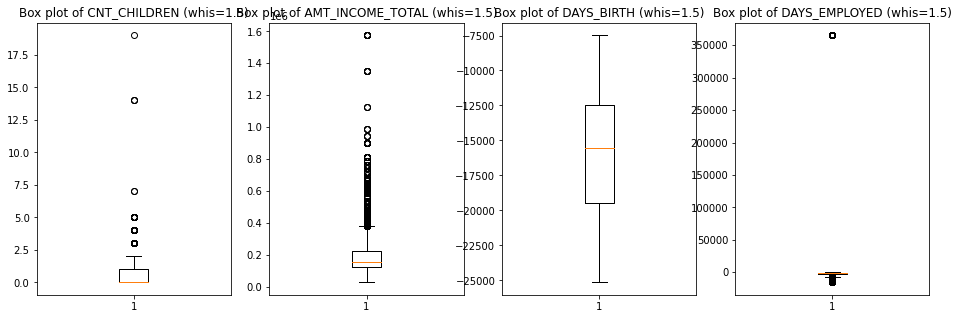

In [ ]:
plt.figure(figsize = (16,5))

plt.subplot(1,4,1)
plt.boxplot(application_total_filtered['CNT_CHILDREN'])
plt.title('Box plot of CNT_CHILDREN (whis=1.5)')

plt.subplot(1,4,2)
plt.boxplot(application_total_filtered['AMT_INCOME_TOTAL'])
plt.title('Box plot of AMT_INCOME_TOTAL (whis=1.5)')

plt.subplot(1,4,3)
plt.boxplot(application_total_filtered['DAYS_BIRTH'])
plt.title('Box plot of DAYS_BIRTH (whis=1.5)')

plt.subplot(1,4,4)
plt.boxplot(application_total_filtered['DAYS_EMPLOYED'])
plt.title('Box plot of DAYS_EMPLOYED (whis=1.5)')

There seems to be some outliers in the number of children, applicants that have more than 17 children. Also, there is a very noticeble outlier in the Days_Employed column. There are some outliers in the AMT_INCOM_TOTAL, but that information will be kept because there could be some business owners and executives that can have those high incomes.

In [ ]:
winsorized_CNT_CHILDREN = winsorize(application_total_filtered['CNT_CHILDREN'], (0.0, 0.00014))

winsorized_DAYS_EMPLOYED = winsorize(application_total_filtered['DAYS_EMPLOYED'], (0.0, 0.2))

Text(0.5, 1.0, 'Box plot of winsorized_DAYS_EMPLOYED (whis=1.5)')

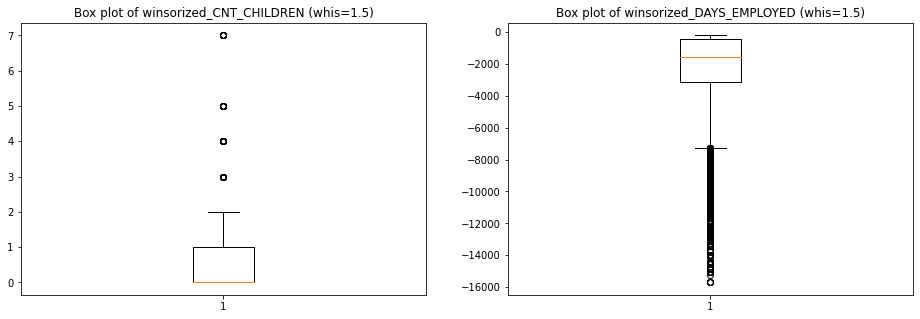

In [ ]:
plt.figure(figsize = (16,5))

plt.subplot(1,2,1)
plt.boxplot(winsorized_CNT_CHILDREN)
plt.title('Box plot of winsorized_CNT_CHILDREN (whis=1.5)')

plt.subplot(1,2,2)
plt.boxplot(winsorized_DAYS_EMPLOYED)
plt.title('Box plot of winsorized_DAYS_EMPLOYED (whis=1.5)')

After applying winsorization for number of children that the applicant has and days of employment and removed the more noticeble outliers some information decisions need to be made for both variables. It is not common but absolutely possible (especially in a sample with more than 30K applicants) that a couple (or few) has 3 to 7 children. Also for the Days that a person has been employed, the positive outlier was removed. A positive value means that the person is unemployed. It would be interesting to check the credit history for an unemployed person or group, but since it was only one point it was excluded as part of the winsorization of the data. Now, once that point is excluded, an interested data is shown. There are some points that show people working for -14000 to -16000 days, that is 38 to 43 years. This data is uncommom, but for now it will be kept in the dataset. In the dataset, for days birth (which is related to the age of the person) seems like there is some people with age above 60, those could the very well the applicants with 40 years work history.

In [ ]:
application_total_filtered['CNT_CHILDREN'] = winsorized_CNT_CHILDREN

application_total_filtered['DAYS_EMPLOYED'] = winsorized_DAYS_EMPLOYED


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Jarque-Bera test statistics is 41880.26979820876 and p value is 0.0
Normality test statistics is 12784.29229910004 and p value is 0.0
DescribeResult(nobs=36457, minmax=(0.0, 7.0), mean=0.4294099898510574, variance=0.5312318029647163, skewness=1.814185137693315, kurtosis=3.7954078495697727)


Text(0.5, 1.0, 'Histogram of CNT_CHILDREN')

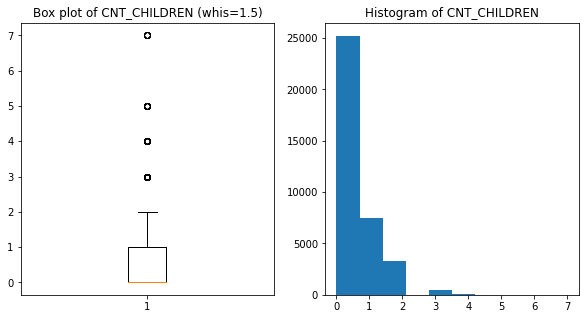

In [ ]:
from scipy.stats import jarque_bera
from scipy.stats import normaltest

plt.figure(figsize = (10,5))

jb_stats = jarque_bera(application_total_filtered['CNT_CHILDREN'])
norm_stats = normaltest(application_total_filtered['CNT_CHILDREN'])

print("Jarque-Bera test statistics is {0} and p value is {1}".format(jb_stats[0], jb_stats[1]))
print("Normality test statistics is {0} and p value is {1}".format(norm_stats[0], norm_stats[1]))
print(stats.describe(application_total_filtered['CNT_CHILDREN']))

plt.subplot(1,2,1)
plt.boxplot(application_total_filtered['CNT_CHILDREN'])
plt.title('Box plot of CNT_CHILDREN (whis=1.5)')

plt.subplot(1,2,2)
plt.hist(application_total_filtered['CNT_CHILDREN'])
plt.title('Histogram of CNT_CHILDREN')

Jarque-Bera test statistics is 45382.19906253972 and p value is 0.0
Normality test statistics is 13037.900352827055 and p value is 0.0
DescribeResult(nobs=36457, minmax=(-15713.0, -200.0), mean=-2235.7888745645555, variance=5451679.171932398, skewness=-1.8230197685831069, kurtosis=4.072093025773694)


Text(0.5, 1.0, 'Histogram of DAYS_EMPLOYED')

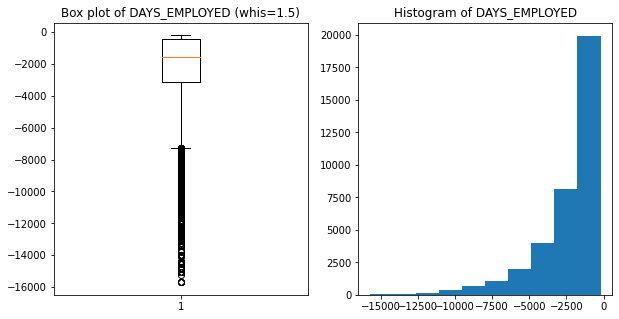

In [ ]:
plt.figure(figsize = (10,5))

jb_stats = jarque_bera(application_total_filtered['DAYS_EMPLOYED'])
norm_stats = normaltest(application_total_filtered['DAYS_EMPLOYED'])

print("Jarque-Bera test statistics is {0} and p value is {1}".format(jb_stats[0], jb_stats[1]))
print("Normality test statistics is {0} and p value is {1}".format(norm_stats[0], norm_stats[1]))
print(stats.describe(application_total_filtered['DAYS_EMPLOYED']))

plt.subplot(1,2,1)
plt.boxplot(application_total_filtered['DAYS_EMPLOYED'])
plt.title('Box plot of DAYS_EMPLOYED (whis=1.5)')

plt.subplot(1,2,2)
plt.hist(application_total_filtered['DAYS_EMPLOYED'])
plt.title('Histogram of DAYS_EMPLOYED')

Obviously as per visual inspection of the data as well as Jaquer Bera and Normality test results, Days Employed is not a normally distributed variable.

Jarque-Bera test statistics is 1867.1541344081697 and p value is 0.0
Normality test statistics is 10997.939961996919 and p value is 0.0
DescribeResult(nobs=36457, minmax=(-25152.0, -7489.0), mean=-15975.17338234084, variance=17644619.83001564, skewness=-0.18422206947290823, kurtosis=-1.0456647464067057)


Text(0.5, 1.0, 'Histogram of DAYS_BIRTH')

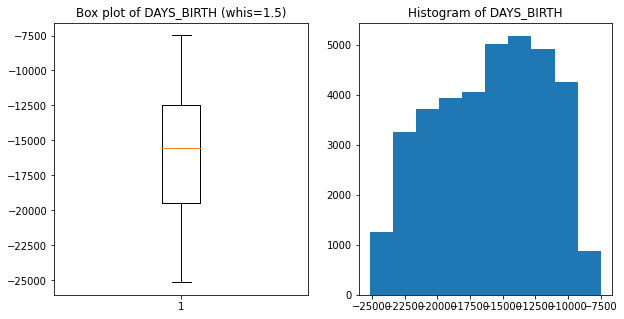

In [ ]:
plt.figure(figsize = (10,5))

jb_stats = jarque_bera(application_total_filtered['DAYS_BIRTH'])
norm_stats = normaltest(application_total_filtered['DAYS_BIRTH'])

print("Jarque-Bera test statistics is {0} and p value is {1}".format(jb_stats[0], jb_stats[1]))
print("Normality test statistics is {0} and p value is {1}".format(norm_stats[0], norm_stats[1]))
print(stats.describe(application_total_filtered['DAYS_BIRTH']))

plt.subplot(1,2,1)
plt.boxplot(application_total_filtered['DAYS_BIRTH'])
plt.title('Box plot of DAYS_BIRTH (whis=1.5)')

plt.subplot(1,2,2)
plt.hist(application_total_filtered['DAYS_BIRTH'])
plt.title('Histogram of DAYS_BIRTH')

Jarque-Bera test statistics is 515878.8059913291 and p value is 0.0
Normality test statistics is 23412.9421815077 and p value is 0.0
DescribeResult(nobs=36457, minmax=(27000.0, 1575000.0), mean=186685.73666236937, variance=10361046627.87445, skewness=2.7388971801516564, kurtosis=17.595506164509807)


Text(0.5, 1.0, 'Histogram of AMT_INCOME_TOTAL')

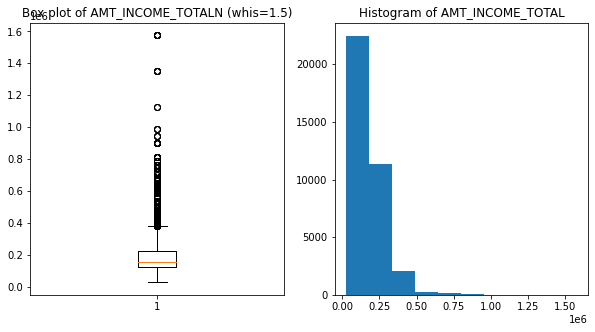

In [ ]:
plt.figure(figsize = (10,5))

jb_stats = jarque_bera(application_total_filtered['AMT_INCOME_TOTAL'])
norm_stats = normaltest(application_total_filtered['AMT_INCOME_TOTAL'])

print("Jarque-Bera test statistics is {0} and p value is {1}".format(jb_stats[0], jb_stats[1]))
print("Normality test statistics is {0} and p value is {1}".format(norm_stats[0], norm_stats[1]))
print(stats.describe(application_total_filtered['AMT_INCOME_TOTAL']))

plt.subplot(1,2,1)
plt.boxplot(application_total_filtered['AMT_INCOME_TOTAL'])
plt.title('Box plot of AMT_INCOME_TOTALN (whis=1.5)')

plt.subplot(1,2,2)
plt.hist(application_total_filtered['AMT_INCOME_TOTAL'])
plt.title('Histogram of AMT_INCOME_TOTAL')

None of the numerical values have a normal distribution. Techniques that require a normal distribution can not be applied unless some data transformation is applied

Let's perform some Data Exploration:

In [ ]:
application_total_filtered.describe()

,ID,MAX,MIN,MODE,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
count,3.645700e+04,36457.000000,36457.000000,36457.000000,36457.000000,3.645700e+04,36457.000000,36457.000000,36457.0,36457.000000,36457.000000,36457.000000,36457.000000
mean,5.078227e+06,-0.059988,-1.400389,-0.732617,0.429410,1.866857e+05,-15975.173382,-2235.788875,1.0,0.225526,0.294813,0.089722,2.198453
std,4.187524e+04,0.831672,0.719194,0.784029,0.728857,1.017892e+05,4200.549944,2334.883117,0.0,0.417934,0.455965,0.285787,0.911686
min,5.008804e+06,-2.000000,-2.000000,-2.000000,0.000000,2.700000e+04,-25152.000000,-15713.000000,1.0,0.000000,0.000000,0.000000,1.000000
25%,5.042028e+06,0.000000,-2.000000,-1.000000,0.000000,1.215000e+05,-19438.000000,-3153.000000,1.0,0.000000,0.000000,0.000000,2.000000
50%,5.074614e+06,0.000000,-2.000000,-1.000000,0.000000,1.575000e+05,-15563.000000,-1552.000000,1.0,0.000000,0.000000,0.000000,2.000000
75%,5.115396e+06,0.000000,-1.000000,0.000000,1.000000,2.250000e+05,-12462.000000,-408.000000,1.0,0.000000,1.000000,0.000000,3.000000
max,5.150487e+06,5.000000,1.000000,5.000000,7.000000,1.575000e+06,-7489.000000,-200.000000,1.0,1.000000,1.000000,1.000000,20.000000


In [ ]:
# Descriptive statistics for just text-based variables
application_total_filtered.describe(include=['O'])

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE
count,36457,36457,36457,36457,36457,36457,36457,36457
unique,2,2,2,5,5,5,6,19
top,F,N,Y,Working,Secondary / secondary special,Married,House / apartment,Unknown
freq,24430,22614,24506,18819,24777,25048,32548,11323


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


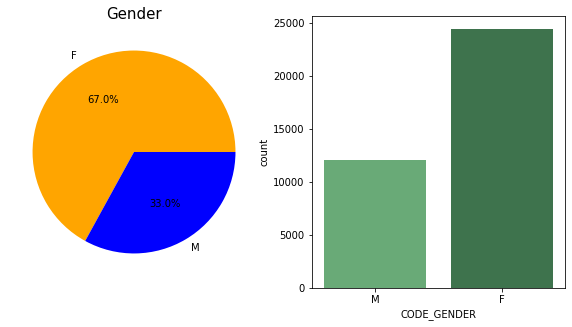

In [ ]:
colors = ['orange', 'blue']

explode = [0,0]
plt.figure(figsize = (10,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('CODE_GENDER')['CODE_GENDER'].count()], labels = application_total_filtered.groupby('CODE_GENDER')['CODE_GENDER'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('Gender',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='CODE_GENDER', data=application_total_filtered, palette='Greens_d')

plt.show()

In [ ]:
# Create crosstab of Attrition Flag by Gender
count_table_gender = pd.crosstab(application_total_filtered['MODE'], application_total_filtered['CODE_GENDER'])
count_table_gender

CODE_GENDER,F,M
MODE,,
-2,4544,2312
-1,8914,4390
0,10908,5271
1,38,32
2,0,1
5,26,21


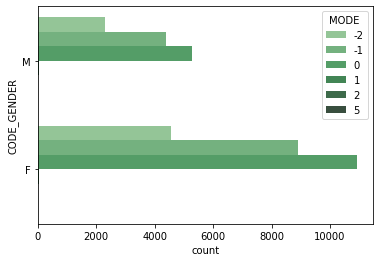

In [ ]:
# Plot counts for each combination of levels.
sns.countplot(y='CODE_GENDER', hue='MODE', data=application_total_filtered, palette="Greens_d")
plt.show()

Females represent double the number of credit card applications than males. The crosstab above shows that the status for the different MODE numbers for males and females. Almost all numbers show double values for females than males, which tells that they are proportionally as him the same MODE values, except fr MODE (Status) number 1 and 5 where males seem to have a higher proportion than females.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


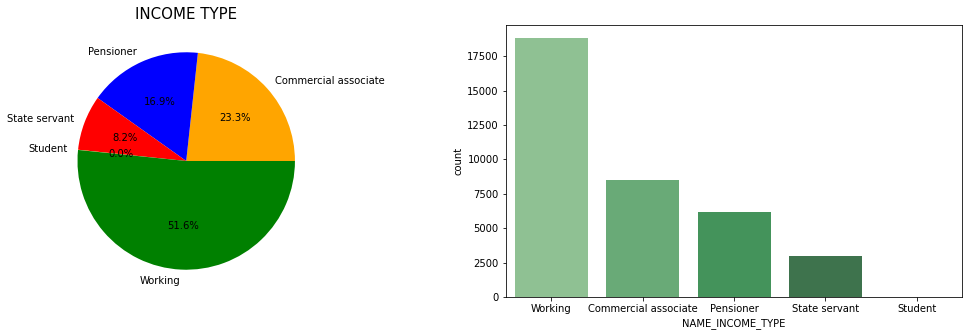

In [ ]:
colors = ['orange', 'blue', 'red', 'yellow', 'green']
explode = [0,0,0,0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_INCOME_TYPE')['NAME_INCOME_TYPE'].count()], labels = application_total_filtered.groupby('NAME_INCOME_TYPE')['NAME_INCOME_TYPE'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('INCOME TYPE',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_INCOME_TYPE', data=application_total_filtered, palette='Greens_d')
plt.show()

Half of the applicants have Working Type income, while there is no students in the application. Students data could be dropped when performing feature engineering. Commercial associate also belongs to the working category, therefore they will be joined in a single category called Working Private Sector, to separate from "State Servant" that would be Working Public Sector. Pensioner will be renamed as Retired.

In [ ]:
application_total_filtered = application_total_filtered.replace({'NAME_INCOME_TYPE': {'Commercial associate': 'Working Private', 'Working': 'Working Private', 'Pensioner': 'Retired', 'State servant': 'Working Public'}})

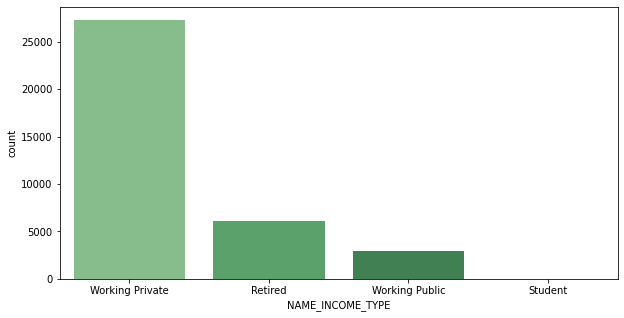

In [ ]:
plt.figure(figsize=(10,5))
sns.countplot(x='NAME_INCOME_TYPE', data=application_total_filtered, palette='Greens_d')
plt.show()

In [ ]:
application_total_filtered.iloc[(application_total_filtered['NAME_INCOME_TYPE'] == 'Student').values]

,ID,MAX,MIN,MODE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
4539,5010456,0,-2,-2,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4540,5010457,0,-1,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4541,5010458,0,-2,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4542,5010459,0,-2,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4543,5010460,0,-2,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4544,5010461,0,-2,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4545,5010462,0,-1,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
4546,5010463,0,-2,-1,F,N,Y,0.0,171000.0,Student,Higher education,Married,House / apartment,-18756.0,-3904.0,1.0,0.0,0.0,1.0,Core staff,2.0
11190,5025088,1,-1,0,M,N,N,0.0,135000.0,Student,Higher education,Single / not married,With parents,-9115.0,-581.0,1.0,0.0,0.0,1.0,Unknown,1.0
17040,5047796,0,-2,0,F,N,Y,1.0,112500.0,Student,Secondary / secondary special,Civil marriage,House / apartment,-12127.0,-795.0,1.0,0.0,0.0,0.0,Laborers,3.0


Only 11 Students in the whole dataset

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


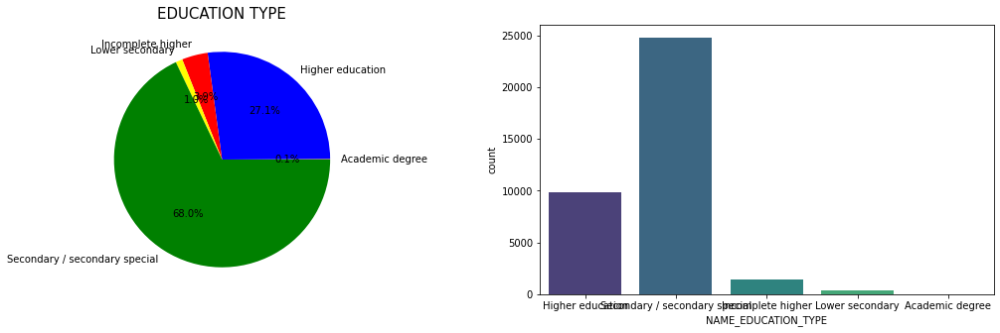

In [ ]:
colors = ['orange', 'blue', 'red', 'yellow', 'green']
explode = [0,0,0,0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_EDUCATION_TYPE')['NAME_EDUCATION_TYPE'].count()], labels = application_total_filtered.groupby('NAME_EDUCATION_TYPE')['NAME_EDUCATION_TYPE'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('EDUCATION TYPE',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_EDUCATION_TYPE', data=application_total_filtered, palette='viridis')

plt.show()

In [ ]:
application_total_filtered['NAME_EDUCATION_TYPE'].unique()

array(['Higher education', 'Secondary / secondary special',
       'Incomplete higher', 'Lower secondary', 'Academic degree'],
      dtype=object)

Higher Education will be merge with Academic degree to reduce the amount of categories, as well as Secondary and Secondary special will be merge with Lower Secondary.

In [ ]:
application_total_filtered = application_total_filtered.replace({'NAME_EDUCATION_TYPE': {'Academic degree': 'Higher education', 'Lower secondary': 'Secondary / secondary special'}})

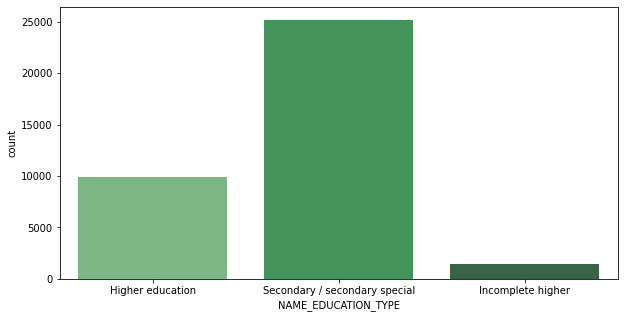

In [ ]:
plt.figure(figsize=(10,5))
sns.countplot(x='NAME_EDUCATION_TYPE', data=application_total_filtered, palette='Greens_d')
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


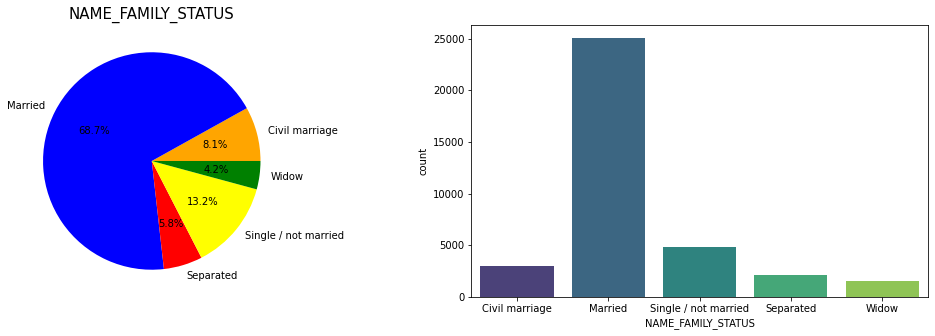

In [ ]:
colors = ['orange', 'blue', 'red', 'yellow', 'green']
explode = [0,0,0,0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_FAMILY_STATUS')['NAME_FAMILY_STATUS'].count()], labels = application_total_filtered.groupby('NAME_FAMILY_STATUS')['NAME_FAMILY_STATUS'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('NAME_FAMILY_STATUS',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_FAMILY_STATUS', data=application_total_filtered, palette='viridis')

plt.show()

Most of the applicants are married. Married and civil marriage are in the same category, because they have the same legal implications. They will be group under one category which will be "Married". Below, the updated plots:

In [ ]:
application_total_filtered = application_total_filtered.replace({'NAME_FAMILY_STATUS': {'Civil marriage': 'Married'}})

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


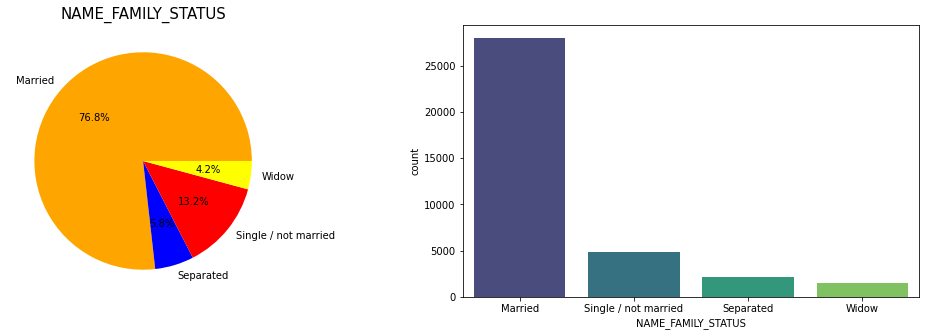

In [ ]:
colors = ['orange', 'blue', 'red', 'yellow', 'green']
explode = [0,0,0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_FAMILY_STATUS')['NAME_FAMILY_STATUS'].count()], labels = application_total_filtered.groupby('NAME_FAMILY_STATUS')['NAME_FAMILY_STATUS'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('NAME_FAMILY_STATUS',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_FAMILY_STATUS', data=application_total_filtered, palette='viridis')

plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


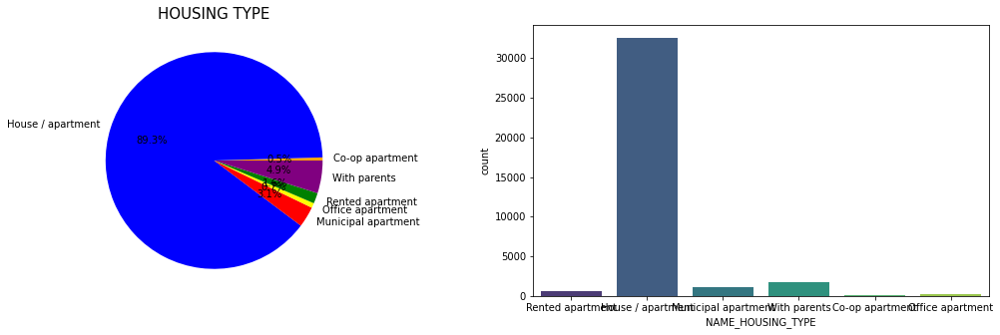

In [ ]:
colors = ['orange', 'blue', 'red', 'yellow', 'green', 'purple']
explode = [0,0,0,0,0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_HOUSING_TYPE')['NAME_HOUSING_TYPE'].count()], labels = application_total_filtered.groupby('NAME_HOUSING_TYPE')['NAME_HOUSING_TYPE'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('HOUSING TYPE',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_HOUSING_TYPE', data=application_total_filtered, palette='viridis')

plt.show()

There are some unnecessary categories in the housing type. There is a cathegory for Living with parents and different type of appartments as well as House / apartment. It does not specify if the House / apartment is owned or rented, so it could as well be rented, like the apartments. Data will be grouped into 2 categories: the ones living in house /apartment (assume to be paid by the person) and another group that lives with the parents or municipal apartments that are assume to get some help with living arrangements

In [ ]:
application_total_filtered = application_total_filtered.replace({'NAME_HOUSING_TYPE': {'Rented apartment': 'House / apartment', 'Co-op apartment': 'House / apartment',
                                                                                       'With parents': 'Others', 'Municipal apartment': 'Others', 
                                                                                       'Office apartment': 'Others'}})

In [ ]:
application_total_filtered['NAME_HOUSING_TYPE'].unique()

array(['House / apartment', 'Others'], dtype=object)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


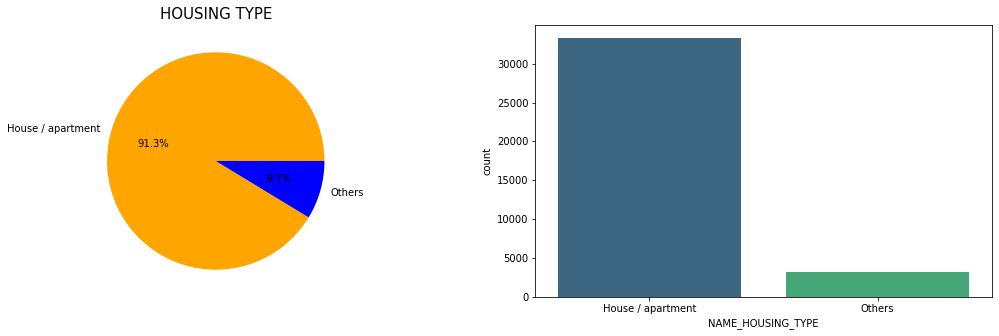

In [ ]:
colors = ['orange', 'blue']
explode = [0,0]

plt.figure(figsize = (18,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('NAME_HOUSING_TYPE')['NAME_HOUSING_TYPE'].count()], labels = application_total_filtered.groupby('NAME_HOUSING_TYPE')['NAME_HOUSING_TYPE'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('HOUSING TYPE',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='NAME_HOUSING_TYPE', data=application_total_filtered, palette='viridis')

plt.show()

In [ ]:
application_total_filtered['OCCUPATION_TYPE'].nunique()

19

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  import sys


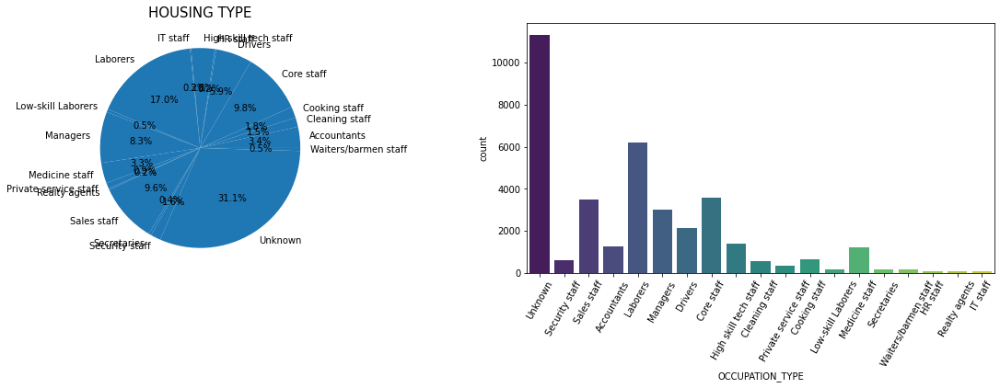

In [ ]:
colors = ['tab:blue']
explode = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]

plt.figure(figsize = (20,5))

plt.subplot(1,2,1)
plt.pie([application_total_filtered.groupby('OCCUPATION_TYPE')['OCCUPATION_TYPE'].count()], labels = application_total_filtered.groupby('OCCUPATION_TYPE')['OCCUPATION_TYPE'].count().index, explode=explode,colors=colors, autopct='%1.1f%%')
plt.title('HOUSING TYPE',color = 'Black',fontsize = 15)

plt.subplot(1,2,2)
sns.countplot(x='OCCUPATION_TYPE', data=application_total_filtered, palette='viridis')
plt.xticks(rotation=60)

plt.show()

In [ ]:
application_total_filtered['OCCUPATION_TYPE'].unique()

array(['Unknown', 'Security staff', 'Sales staff', 'Accountants',
       'Laborers', 'Managers', 'Drivers', 'Core staff',
       'High skill tech staff', 'Cleaning staff', 'Private service staff',
       'Cooking staff', 'Low-skill Laborers', 'Medicine staff',
       'Secretaries', 'Waiters/barmen staff', 'HR staff', 'Realty agents',
       'IT staff'], dtype=object)

There are too many occupations in OCCUPATION_TYPE, and some of them are duplicated like Low-skill Laborers and Laborers and Cleaning staff. Considering that the ocupations will be grouped:

In [ ]:
application_total_filtered = application_total_filtered.replace({'OCCUPATION_TYPE': {'Low-skill Laborers': 'General Laborer', 'Cleaning staff': 'General Laborer', 'Laborers': 'General Laborer', 'Drivers': 'General Laborer', 'Security staff': 'General Laborer', 'Managers': 'High Skill Jobs', 'Medicine staff': 'High Skill Jobs', 'IT staff': 'High skill tech staff', 'Accountants': 'High Skill Jobs', 'Realty agents': 'Sales staff', 'Secretaries': 'Core staff', 'HR staff': 'Core staff', 
                                                                                     'Waiters/barmen staff': 'Hospitality Service', 'Cooking staff': 'Hospitality Service'}})

In [ ]:
application_total_filtered['OCCUPATION_TYPE'].nunique()

8

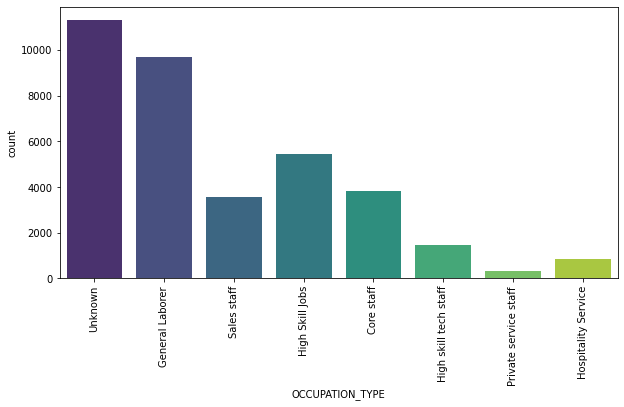

In [ ]:
plt.figure(figsize = (10,5))
sns.countplot(x='OCCUPATION_TYPE', data=application_total_filtered, palette='viridis')
plt.xticks(rotation=90)
plt.show()

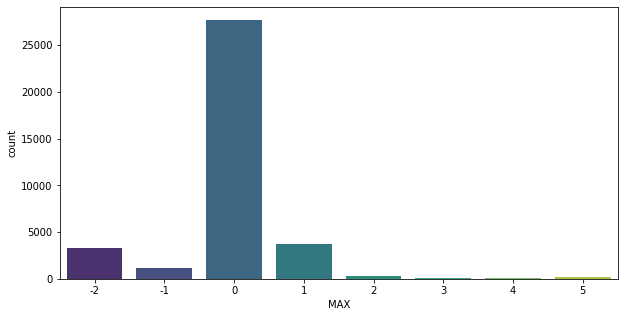

In [ ]:
plt.figure(figsize = (10,5))
sns.countplot(x='MAX', data=application_total_filtered, palette='viridis')
plt.show()

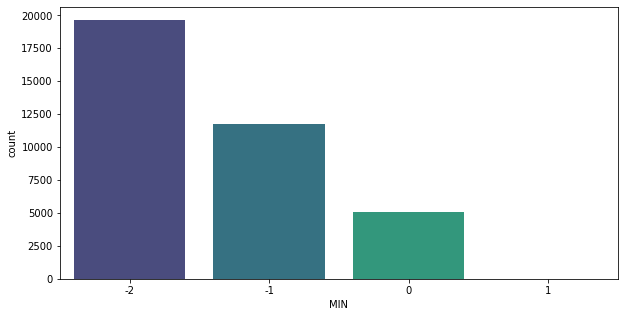

In [ ]:
plt.figure(figsize = (10,5))
sns.countplot(x='MIN', data=application_total_filtered, palette='viridis')
plt.show()

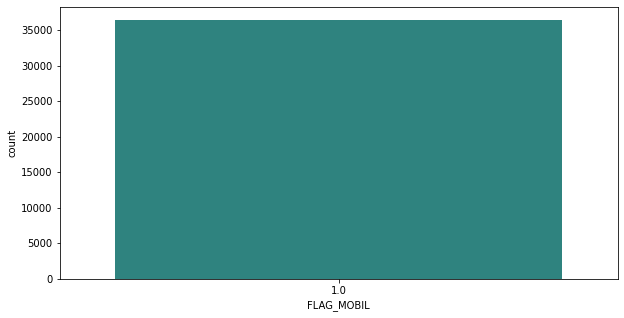

In [ ]:
plt.figure(figsize = (10,5))
sns.countplot(x='FLAG_MOBIL', data=application_total_filtered, palette='viridis')
plt.show()

Flag_mobile seems to be a constant since everybody has one (Flag = 1). If it is the same for every applicant, it does not seem to add anything to the model. Therefore it will be delated from the dataset

In [ ]:
application_total_filtered.drop(['FLAG_MOBIL'], axis=1, inplace=True)
application_total_filtered

,ID,MAX,MIN,MODE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
3231,5008804,1,-2,-1,M,Y,Y,0.0,427500.0,Working Private,Higher education,Married,House / apartment,-12005.0,-4542.0,1.0,0.0,0.0,Unknown,2.0
3232,5008805,1,-2,-1,M,Y,Y,0.0,427500.0,Working Private,Higher education,Married,House / apartment,-12005.0,-4542.0,1.0,0.0,0.0,Unknown,2.0
3233,5008806,0,-2,-2,M,Y,Y,0.0,112500.0,Working Private,Secondary / secondary special,Married,House / apartment,-21474.0,-1134.0,0.0,0.0,0.0,General Laborer,2.0
3234,5008808,0,-2,-2,F,N,Y,0.0,270000.0,Working Private,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,0.0,1.0,1.0,Sales staff,1.0
3235,5008809,-2,-2,-2,F,N,Y,0.0,270000.0,Working Private,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,0.0,1.0,1.0,Sales staff,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,F,Y,Y,1.0,157500.0,Working Private,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,0.0,0.0,0.0,Core staff,3.0
45981,5150483,-2,-2,-2,F,Y,Y,1.0,157500.0,Working Private,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,0.0,0.0,0.0,Core staff,3.0
45982,5150484,0,-1,0,F,Y,Y,1.0,157500.0,Working Private,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,0.0,0.0,0.0,Core staff,3.0
45983,5150485,0,0,0,F,Y,Y,1.0,157500.0,Working Private,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,0.0,0.0,0.0,Core staff,3.0


Most of the people have a Secondary or Secondary special education. There is minimum people with Academic degree

In [ ]:
 #bivariate analysis
 
 application_total_filtered.corr()

,ID,MAX,MIN,MODE,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS
ID,1.000000,-0.002801,0.023834,-0.015829,0.029445,-0.017667,0.056016,0.006950,0.079215,0.009879,-0.046979,0.026624
MAX,-0.002801,1.000000,0.229820,0.484272,0.000458,-0.002930,-0.000242,-0.000178,-0.004244,-0.008408,0.014221,-0.003400
MIN,0.023834,0.229820,1.000000,0.361542,0.011727,-0.032828,0.019814,0.017198,-0.009856,-0.018537,0.012235,0.007397
MODE,-0.015829,0.484272,0.361542,1.000000,-0.013243,0.003852,-0.020108,-0.003530,-0.015857,-0.008351,0.007883,-0.009921
CNT_CHILDREN,0.029445,0.000458,0.011727,-0.013243,1.000000,0.034347,0.345453,-0.037739,0.048572,-0.016780,0.016645,0.885679
AMT_INCOME_TOTAL,-0.017667,-0.002930,-0.032828,0.003852,0.034347,1.000000,0.067908,-0.082849,-0.037746,0.017245,0.086681,0.023750
DAYS_BIRTH,0.056016,-0.000242,0.019814,-0.020108,0.345453,0.067908,1.000000,-0.004387,0.179054,-0.028659,0.105625,0.304020
DAYS_EMPLOYED,0.006950,-0.000178,0.017198,-0.003530,-0.037739,-0.082849,-0.004387,1.000000,-0.105176,-0.043482,0.004974,-0.048403
FLAG_WORK_PHONE,0.079215,-0.004244,-0.009856,-0.015857,0.048572,-0.037746,0.179054,-0.105176,1.000000,0.311644,-0.034838,0.064527
FLAG_PHONE,0.009879,-0.008408,-0.018537,-0.008351,-0.016780,0.017245,-0.028659,-0.043482,0.311644,1.000000,0.010455,-0.004221


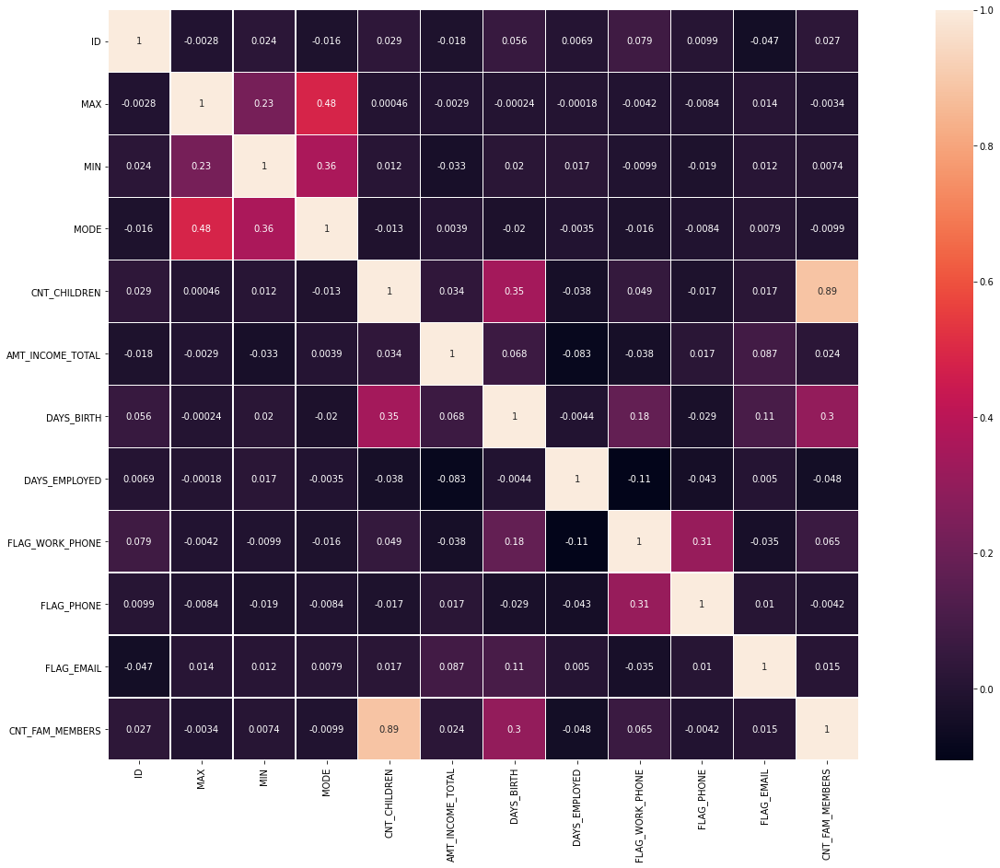

In [ ]:
corrmat_application_total = application_total_filtered.corr()

plt.figure(figsize=(30,15))

sns.heatmap(corrmat_application_total, square=True, annot=True, linewidths=.5)

The only significant relations in the correlation matrix is among number of family members and number of children (because of course kids are family members). Also number of children is related to age. Because this is a high dimension dataset and number of children information is already included in number of family members, number of children column will be dropped.

In [ ]:
# Descriptive statistics for just text-based variables
application_total_filtered.describe(include=['O'])

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE
count,36457,36457,36457,36457,36457,36457,36457,36457
unique,2,2,2,4,3,4,2,8
top,F,N,Y,Working Private,Secondary / secondary special,Married,House / apartment,Unknown
freq,24430,22614,24506,27309,25151,27993,33291,11323


***Feature Engineering:***

For better handling of the information, categorical variables will be converted to dummies (hot encoding):

In [ ]:
application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['CODE_GENDER'], prefix='Gender', drop_first=True)], axis=1)
application_total_filtered.drop(['CODE_GENDER'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['FLAG_OWN_CAR'], prefix='Own_Car', drop_first=True)], axis=1)
application_total_filtered.drop(['FLAG_OWN_CAR'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['FLAG_OWN_REALTY'], prefix='Own_Realty', drop_first=True)], axis=1)
application_total_filtered.drop(['FLAG_OWN_REALTY'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['NAME_FAMILY_STATUS'], prefix='Family_Status')], axis=1)
application_total_filtered.drop(['NAME_FAMILY_STATUS', 'Family_Status_Widow'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['NAME_INCOME_TYPE'], prefix='Income_Type')], axis=1)
application_total_filtered.drop(['NAME_INCOME_TYPE', 'Income_Type_Student'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['NAME_HOUSING_TYPE'], prefix='Housing_Type')], axis=1)
application_total_filtered.drop(['NAME_HOUSING_TYPE', 'Housing_Type_Others'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['NAME_EDUCATION_TYPE'], prefix='Education_Type')], axis=1)
application_total_filtered.drop(['NAME_EDUCATION_TYPE', 'Education_Type_Incomplete higher'], axis=1, inplace=True)

application_total_filtered = pd.concat([application_total_filtered, pd.get_dummies(application_total_filtered['OCCUPATION_TYPE'], prefix='Occupation_Type')], axis=1)
application_total_filtered.drop(['OCCUPATION_TYPE', 'Occupation_Type_Unknown'], axis=1, inplace=True)

application_total_filtered.drop(['CNT_CHILDREN'], axis=1, inplace=True)


In [ ]:
application_total_filtered

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff
3231,5008804,1,-2,-1,427500.0,-12005.0,-4542.0,1.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0
3232,5008805,1,-2,-1,427500.0,-12005.0,-4542.0,1.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0
3233,5008806,0,-2,-2,112500.0,-21474.0,-1134.0,0.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0
3234,5008808,0,-2,-2,270000.0,-19110.0,-3051.0,0.0,1.0,1.0,1.0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1
3235,5008809,-2,-2,-2,270000.0,-19110.0,-3051.0,0.0,1.0,1.0,1.0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0
45981,5150483,-2,-2,-2,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0
45982,5150484,0,-1,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0
45983,5150485,0,0,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0


In [ ]:
X = application_total_filtered

In [ ]:
# Standarizing the features
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
# We just want the first two principal components
pca = PCA(n_components=2)

# We get the components by 
# calling fit_transform method with our data
pca_components = pca.fit_transform(X_std)

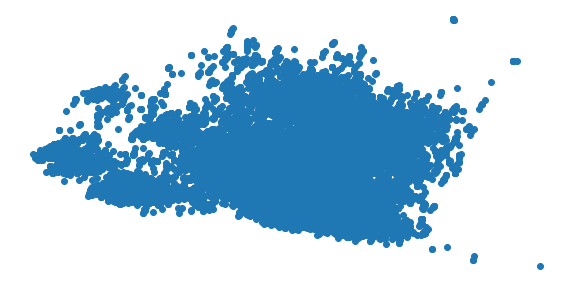

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_components[:, 0], pca_components[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
umap_results = umap.UMAP(n_neighbors=5, min_dist=0.5, metric='cosine').fit_transform(X_std)

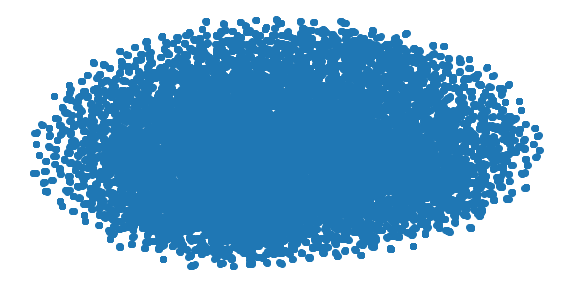

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Using UMAP is not possible to visualize clearly any groups or clusters in the data. Using PCA blocks of groups emerge, at least 2 or 3 well defined groups can be observed. First values for K-means would be 3 clusters and the Silhouette coefficient will be calculated

# Model Selection

## Using K-Means clustering

3 clusters solution:

In [ ]:
k_means = KMeans(n_clusters=3, random_state=123)
%timeit k_means.fit(X_std)
y_pred_3K = k_means.predict(X_std)

1 loop, best of 3: 972 ms per loop


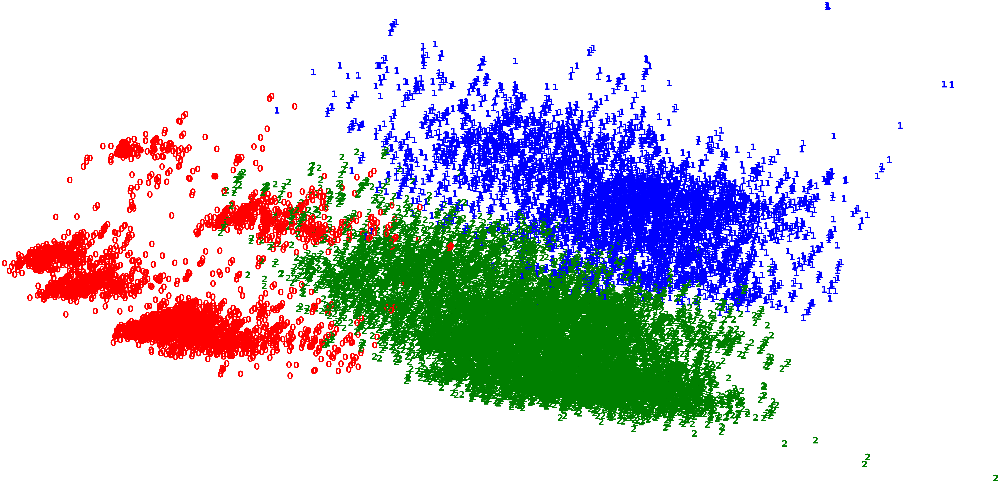

In [ ]:
# visualizing the clusters using PCA

pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = 'rbg'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(y_pred_3K[i]),
             color=colours[y_pred_3K[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
# visualizing the clusters using UMAP

umap_results = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = 'rbg'
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], y_pred_3K[i], color=colours[y_pred_3K[i]], fontdict={'weight': 'bold', 'size': 50})

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

K-means Inertia 3 clusters

In [ ]:
k_means.inertia_

933769.8098030123

Calculating Silhouette Score for 3 clusters:

In [ ]:
# Silhouette coefficient for 3-cluster solution
print("Silhouette score for three cluster k-means: {}".format(metrics.silhouette_score(X_std, y_pred_3K, metric='euclidean')))

Silhouette score for three cluster k-means: 0.10137190867763421


Calculating K-means for different number of clusters:

In [ ]:
clusters = [3,4,5,6,7,8,9,10,11,12]
inertia_score = []
silhouette_score = []
for n in clusters:
  k_means = KMeans(n_clusters=n, random_state=123)
  k_means = k_means.fit(X_std)
  y_pred = k_means.predict(X_std)
  inertia = k_means.inertia_
  inertia_score.append(inertia)
  silhouette = metrics.silhouette_score(X_std, y_pred, metric='euclidean')
  silhouette_score.append(silhouette)
print(inertia_score)
print(silhouette_score)


[933769.8098030123, 882321.744086306, 840995.3318257914, 811549.3226274353, 784826.4277577867, 759641.4861324131, 735669.7786594933, 702647.0485575798, 670979.5214201914, 658078.3846290932]
[0.10137190867763421, 0.11250582522856252, 0.12201210531949963, 0.12896772084627828, 0.1433598042589651, 0.12311370654432774, 0.13748626571001846, 0.12554860648660682, 0.1371164435414643, 0.13012885885317185]


In [ ]:
Kmeans_results = pd.DataFrame()

Kmeans_results['clusters'] = clusters

Kmeans_results['silhouette_score'] = silhouette_score

Kmeans_results['inertia_score'] = inertia_score

Kmeans_results



,clusters,silhouette_score,inertia_score
0,3,0.101372,933769.809803
1,4,0.112506,882321.744086
2,5,0.122012,840995.331826
3,6,0.128968,811549.322627
4,7,0.143360,784826.427758
5,8,0.123114,759641.486132
6,9,0.137486,735669.778659
7,10,0.125549,702647.048558
8,11,0.137116,670979.521420
9,12,0.130129,658078.384629


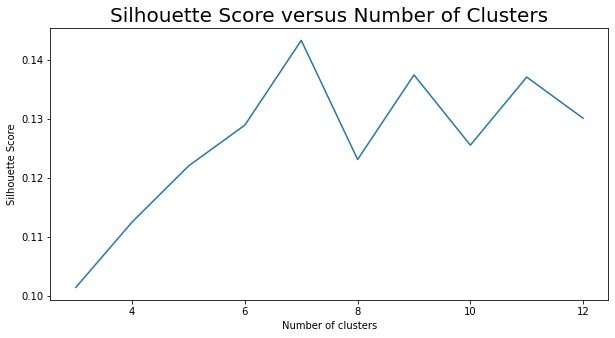

In [ ]:
plt.figure(figsize=(10,5))
plt.plot(Kmeans_results.clusters, Kmeans_results.silhouette_score)
plt.ylabel('Silhouette Score')
plt.xlabel('Number of clusters')
plt.title('Silhouette Score versus Number of Clusters', fontsize=20)
plt.show()

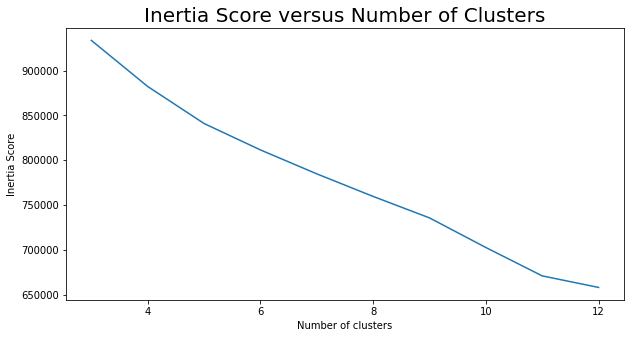

In [ ]:
plt.figure(figsize=(10,5))
plt.plot(Kmeans_results.clusters, Kmeans_results.inertia_score)
plt.ylabel('Inertia Score')
plt.xlabel('Number of clusters')
plt.title('Inertia Score versus Number of Clusters', fontsize=20)
plt.show()

7 clusters solution:

In [ ]:
k_means = KMeans(n_clusters=7, random_state=123)
%timeit k_means.fit(X_std)
y_pred_7K = k_means.predict(X_std)

1 loop, best of 3: 2.02 s per loop


In [ ]:
k_means.inertia_

784826.4277577867

In [ ]:
# Silhouette coefficient for 7-cluster solution
print("Silhouette score for seven cluster k-means: {}".format(metrics.silhouette_score(X_std, y_pred_7K, metric='euclidean')))

Silhouette score for seven cluster k-means: 0.1433598042589651


As per the plot of the Silhoette Score the best number of clusters for K-means is 7 with a score of 0.14.

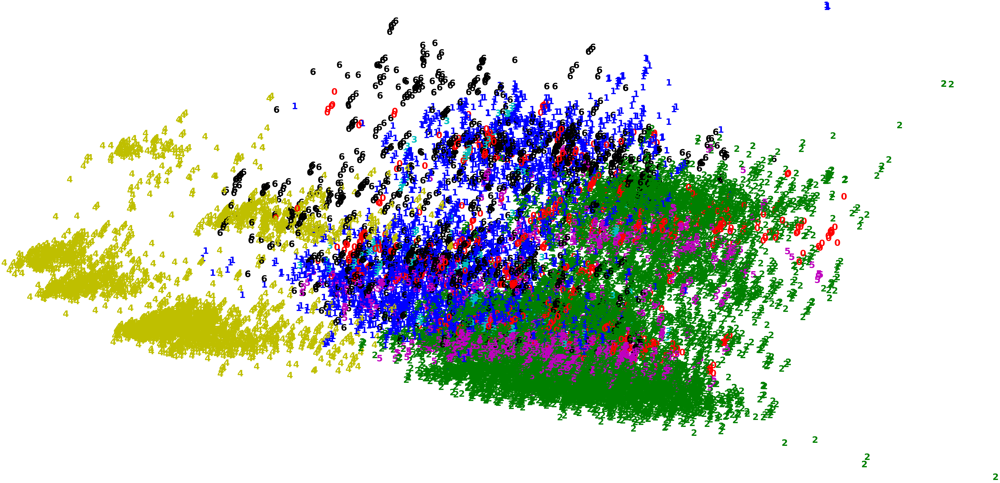

In [ ]:
# visualizing the clusters using PCA

pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ['r', 'b', 'g', 'c', 'y', 'm', 'k']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(y_pred_7K[i]),
             color=colours[y_pred_7K[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

## Using Hierarchical Clustering:

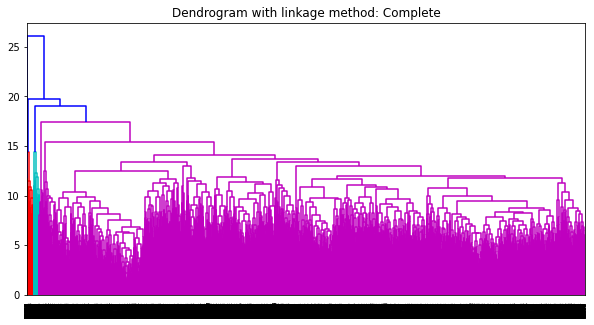

In [ ]:
plt.figure(figsize=(10,5))
dendrogram(linkage(X_std, method='complete'))
plt.title("Dendrogram with linkage method: Complete")
plt.show()

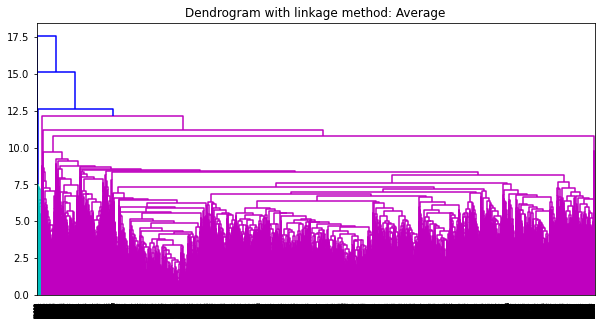

In [ ]:
plt.figure(figsize=(10,5))
dendrogram(linkage(X_std, method='average'))
plt.title("Dendrogram with linkage method: Average")
plt.show()

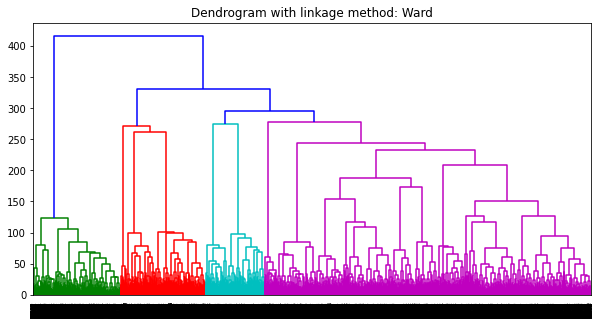

In [ ]:
plt.figure(figsize=(10,5))
dendrogram(linkage(X_std, method='ward'))
plt.title("Dendrogram with linkage method: Ward")
plt.show()

Seems like Ward solution with 8 or 10 clusters would be the best choice. Let's calculate:

8 clusters solution

In [ ]:
# Defining the agglomerative clustering
agg_cluster = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=8)

# Fit model
clusters_agg_8 = agg_cluster.fit_predict(X_std)

Silhouette coefficient for 8-cluster hierarchical solution:

In [ ]:
# Silhouette coefficient for 8-cluster hierarchical solution
print("Silhouette score for eight cluster hierarchical solution: {}".format(metrics.silhouette_score(X_std, clusters_agg_8, metric='euclidean')))

Silhouette score for eight cluster hierarchical solution: 0.15690213358556102


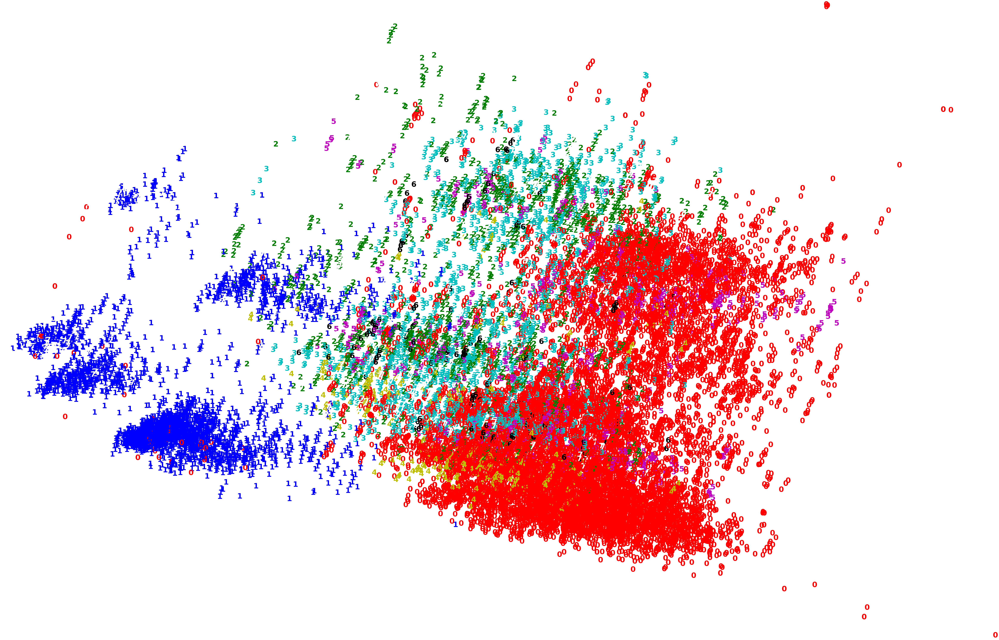

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(12,8))
colours = ['r', 'b', 'g', 'c', 'y', 'm', 'k', 'w']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_agg_8[i]),
             color=colours[clusters_agg_8[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

10 clusters solution

In [ ]:
# Defining the agglomerative clustering
agg_cluster = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=10)

# Fit model
clusters_agg = agg_cluster.fit_predict(X_std)

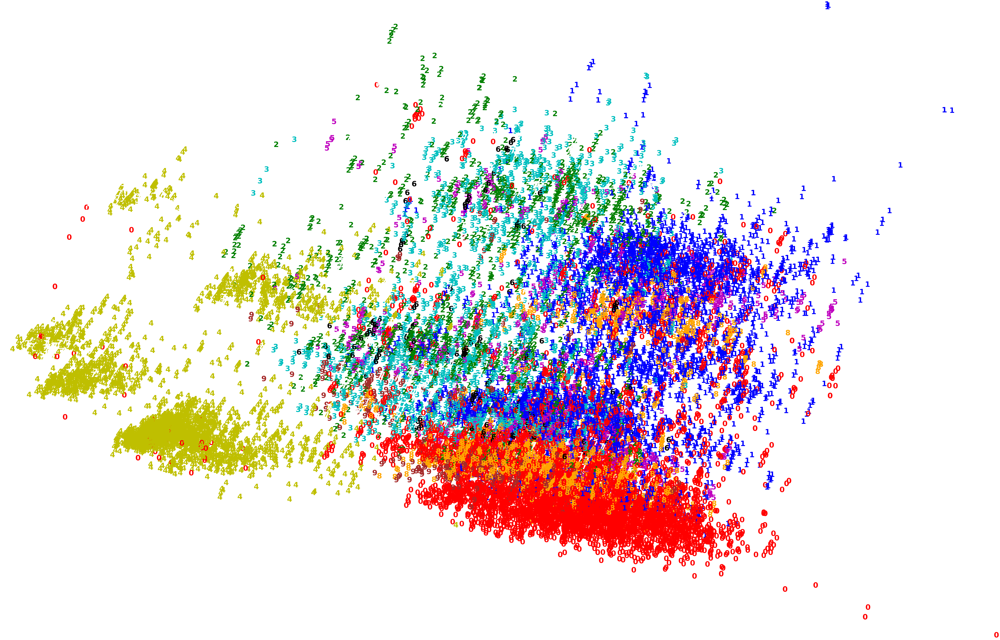

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(12,8))
colours = ['r', 'b', 'g', 'c', 'y', 'm', 'k', 'w', 'orange', 'brown']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_agg[i]),
             color=colours[clusters_agg[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Silhouette coefficient for 10-cluster hierarchical solution:

In [ ]:
# Silhouette coefficient for 10-cluster hierarchical solution
print("Silhouette score for ten cluster hierarchical solution: {}".format(metrics.silhouette_score(X_std, clusters_agg, metric='euclidean')))

Silhouette score for ten cluster hierarchical solution: 0.14491758059791263


Calculating the Silhouette score for different numbers of clusters:

In [ ]:
clusters = [3,4,5,6,7,8,9,10,11,12]
silhouette_score_agg = []
for n in clusters:
# Defining the agglomerative clustering
  agg_cluster = AgglomerativeClustering(linkage='ward', 
                                      affinity='euclidean',
                                      n_clusters=n)

# Fit model
  clusters_agg = agg_cluster.fit_predict(X_std)
  silhouette_agg = metrics.silhouette_score(X_std, clusters_agg, metric='euclidean')
  silhouette_score_agg.append(silhouette_agg)

print(silhouette_score_agg)

[0.08840392618201551, 0.1062831331813258, 0.11995468341867475, 0.13507632224814056, 0.14454949896613692, 0.15690213358556102, 0.14818992059795255, 0.14491758059791263, 0.1451552666472698, 0.14762169328203187]


In [ ]:
H_results = pd.DataFrame()

H_results['clusters'] = clusters

H_results['silhouette_score'] = silhouette_score_agg

H_results

,clusters,silhouette_score
0,3,0.088404
1,4,0.106283
2,5,0.119955
3,6,0.135076
4,7,0.144549
5,8,0.156902
6,9,0.148190
7,10,0.144918
8,11,0.145155
9,12,0.147622


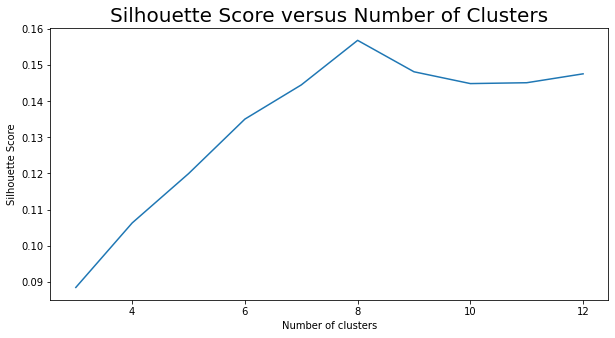

In [ ]:
plt.figure(figsize=(10,5))
plt.plot(H_results.clusters, H_results.silhouette_score)
plt.ylabel('Silhouette Score')
plt.xlabel('Number of clusters')
plt.xticks()
plt.title('Silhouette Score versus Number of Clusters', fontsize=20)
plt.show()

The best number of clusters is 8

# Using DBSCAN clustering

In [ ]:
# Defining the agglomerative clustering
dbscan_cluster = DBSCAN(eps=1, min_samples=5)

# Fit model
clusters_dbscan = dbscan_cluster.fit_predict(X_std)

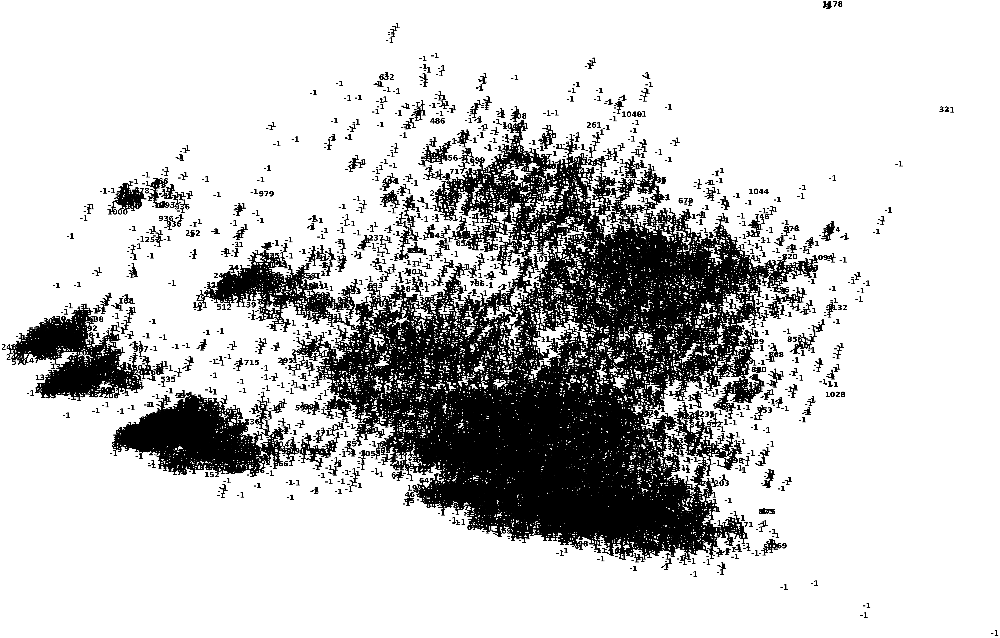

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(12,8))
#colours = ['r', 'b', 'g', 'c']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_dbscan[i]),
#             color=colours[clusters[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [ ]:
# Silhouette coefficient for dbscan solution
print("Silhouette score for three cluster hierarchical solution: {}".format(metrics.silhouette_score(X_std, clusters_dbscan, metric='euclidean')))

Silhouette score for three cluster hierarchical solution: -0.2102937605692427


Data seems to be very interconnected and DBSCAN seems to not be performing very well with this type of data. More than 100 clusters were identified, which is not grouping the data as needed. Trying different eps values to look for a better Silhouette Score:

In [ ]:
eps_dbscan = [3,5,6,7,9,10]
silhouette_score_dbscan = []
for n in eps_dbscan:
# Defining the agglomerative clustering
  dbscan_cluster = DBSCAN(eps=n, min_samples=5)

# Fit model
  clusters_dbscan = dbscan_cluster.fit_predict(X_std)
  silhouette_dbscan = metrics.silhouette_score(X_std, clusters_dbscan, metric='euclidean')
  silhouette_score_dbscan.append(silhouette_dbscan)

print(silhouette_score_dbscan)

[-0.012218153861680027, 0.14170642224435895, 0.24622307374531413, 0.4106815635575133, 0.41069459904226957, 0.41056945934725486]


In [ ]:
DBSCAN_results = pd.DataFrame()

DBSCAN_results['eps_dbscan'] = eps_dbscan

DBSCAN_results['silhouette_score'] = silhouette_score_dbscan

DBSCAN_results

,eps_dbscan,silhouette_score
0,3,-0.012218
1,5,0.141706
2,6,0.246223
3,7,0.410682
4,9,0.410695
5,10,0.410569


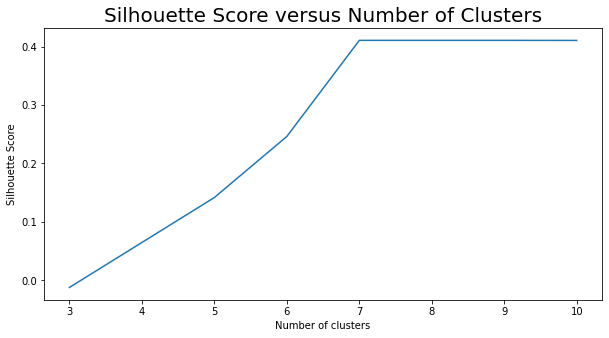

In [ ]:
plt.figure(figsize=(10,5))
plt.plot(DBSCAN_results.eps_dbscan, DBSCAN_results.silhouette_score)
plt.ylabel('Silhouette Score')
plt.xlabel('Number of clusters')
plt.xticks()
plt.title('Silhouette Score versus Number of Clusters', fontsize=20)
plt.show()

In both K-means and DBSCAN the best number of clusters is 7

In [ ]:
# Defining the agglomerative clustering
dbscan_cluster_7 = DBSCAN(eps=7, min_samples=5)

# Fit model
clusters_dbscan_7 = dbscan_cluster_7.fit_predict(X_std)

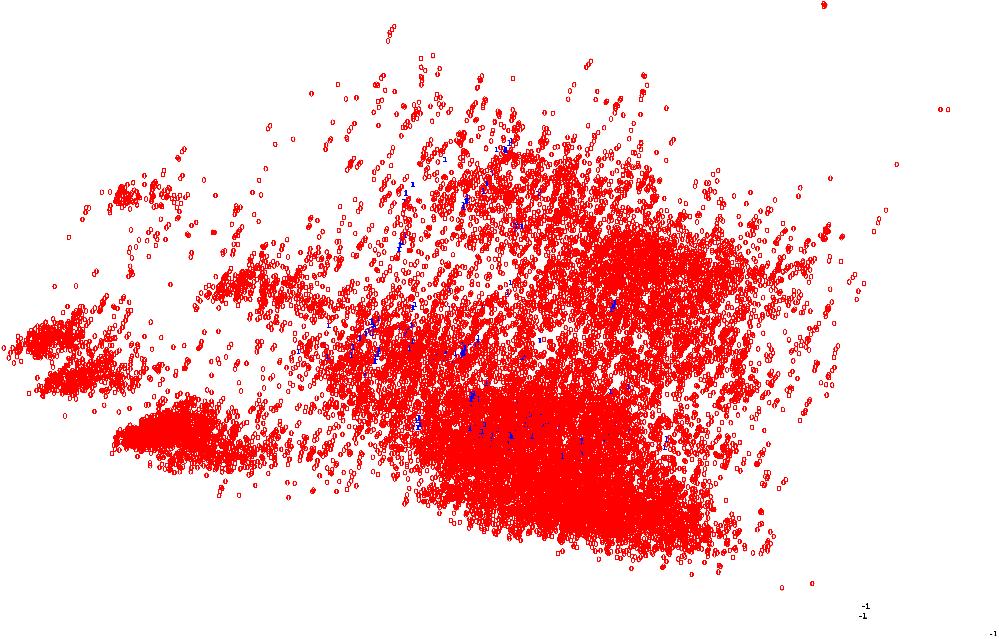

In [ ]:
pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(12,8))
colours = ['r', 'b', 'g', 'c', 'y', 'm', 'k']
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_dbscan_7[i]),
             color=colours[clusters_dbscan_7[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

The value if epsilon 7 has the highest Silhouette value but is gives a total of 2 clusters, plus outliers. Even though the Silhouette value is the higher it is not really separating different clusters, so relying on this value alone to select the best clustering could be risky. With this high dimensional level data set I think more than 2 clusters can be formed. In any case, the best resulting case from Hierarchical Clustering and DBSCAN clusters will be evaluated.

# Clusters Evaluation

Evaluation of the clusters from Hierarchical Clustering Techniques:

In [ ]:
application_data_clusters_agg_8 = application_total_filtered.copy()

In [ ]:
application_data_clusters_agg_8['cluster_labels'] = clusters_agg_8

In [ ]:
application_data_clusters_agg_8

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
3231,5008804,1,-2,-1,427500.0,-12005.0,-4542.0,1.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0
3232,5008805,1,-2,-1,427500.0,-12005.0,-4542.0,1.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0
3233,5008806,0,-2,-2,112500.0,-21474.0,-1134.0,0.0,0.0,0.0,2.0,1,1,1,1,0,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0
3234,5008808,0,-2,-2,270000.0,-19110.0,-3051.0,0.0,1.0,1.0,1.0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,3
3235,5008809,-2,-2,-2,270000.0,-19110.0,-3051.0,0.0,1.0,1.0,1.0,0,0,1,0,0,1,0,1,0,1,0,1,0,0,0,0,0,0,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0
45981,5150483,-2,-2,-2,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0
45982,5150484,0,-1,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0
45983,5150485,0,0,0,157500.0,-10808.0,-1739.0,0.0,0.0,0.0,3.0,0,1,1,1,0,0,0,1,0,1,0,1,1,0,0,0,0,0,0,0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 0].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,2.050400e+04,20504.000000,20504.000000,20504.000000,2.050400e+04,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.000000,20504.0,20504.000000,20504.0
mean,5.079128e+06,-0.041358,-1.401873,-0.725029,1.956634e+05,-14903.095835,-2605.704838,0.283115,0.301502,0.099395,2.525068,0.399093,0.451668,0.653872,0.963178,0.001317,0.012046,0.003219,0.992148,0.004146,0.909140,0.278385,0.675868,0.111100,0.366611,0.193279,0.001122,0.000049,0.0,0.140802,0.0
std,4.163596e+04,0.904581,0.717891,0.803279,1.107369e+05,3465.734307,2319.825912,0.450523,0.458921,0.299199,0.856508,0.489724,0.497671,0.475746,0.188329,0.036265,0.109096,0.056645,0.088266,0.064254,0.287417,0.448215,0.468061,0.314264,0.481891,0.394880,0.033474,0.006984,0.0,0.347825,0.0
min,5.008804e+06,-2.000000,-2.000000,-2.000000,2.700000e+04,-24611.000000,-15713.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
25%,5.042348e+06,0.000000,-2.000000,-1.000000,1.350000e+05,-17450.000000,-3471.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
50%,5.079226e+06,0.000000,-2.000000,-1.000000,1.755000e+05,-14661.000000,-1963.500000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
75%,5.115454e+06,0.000000,-1.000000,0.000000,2.250000e+05,-12079.750000,-962.000000,1.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0
max,5.150487e+06,5.000000,0.000000,5.000000,1.575000e+06,-7705.000000,-200.000000,1.000000,1.000000,1.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,0.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 1].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,5.744000e+03,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.000000,5744.0,5744.000000,5744.0,5744.0,5744.0,5744.000000,5744.000000,5744.000000,5744.0,5744.000000,5744.000000,5744.0,5744.0,5744.0,5744.0,5744.0
mean,5.074676e+06,-0.085306,-1.404248,-0.723712,148383.386229,-21752.530641,-200.547354,0.000174,0.291086,0.036908,1.793175,0.149896,0.215355,0.770021,0.739554,0.0,0.116643,1.0,0.0,0.0,0.968663,0.159645,0.831650,0.0,0.000522,0.000174,0.0,0.0,0.0,0.0,1.0
std,4.170773e+04,0.698023,0.722675,0.749082,75265.766266,1957.952678,27.959577,0.013194,0.454303,0.188553,0.541229,0.357000,0.411104,0.420856,0.438916,0.0,0.321023,0.0,0.0,0.0,0.174242,0.366308,0.374209,0.0,0.022850,0.013194,0.0,0.0,0.0,0.0,0.0
min,5.008827e+06,-2.000000,-2.000000,-2.000000,29250.000000,-25152.000000,-2208.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,1.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0
25%,5.038620e+06,0.000000,-2.000000,-1.000000,94500.000000,-23083.000000,-200.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,1.0,0.0,0.0,1.000000,0.000000,1.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0
50%,5.067308e+06,0.000000,-2.000000,-1.000000,135000.000000,-21979.000000,-200.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.0,0.000000,1.0,0.0,0.0,1.000000,0.000000,1.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0
75%,5.113392e+06,0.000000,-1.000000,0.000000,180000.000000,-20851.000000,-200.000000,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.0,0.000000,1.0,0.0,0.0,1.000000,0.000000,1.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0
max,5.150423e+06,5.000000,0.000000,1.000000,675000.000000,-8145.000000,-200.000000,1.000000,1.000000,1.000000,5.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.0,0.0,0.0,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,0.0,0.0,0.0,0.0,1.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 2].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,2.421000e+03,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.0,2421.000000,2421.000000,2421.0,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.000000,2421.0,2421.0,2421.0,2421.000000,2421.0
mean,5.079645e+06,-0.068567,-1.412639,-0.743494,197560.066914,-15002.128459,-3555.464271,0.243701,0.281702,0.097893,2.406444,0.268484,0.351921,0.617100,0.843866,0.0,0.119785,0.000413,0.0,0.999587,0.884758,0.414705,0.550599,0.358943,0.133416,0.298224,0.0,0.0,0.0,0.004957,2.0
std,4.303166e+04,0.733670,0.720070,0.753973,93027.801982,3578.183150,2576.739325,0.429403,0.449922,0.297232,0.924876,0.443262,0.477668,0.486195,0.363057,0.0,0.324777,0.020324,0.0,0.020324,0.319379,0.492773,0.497536,0.479789,0.340094,0.457573,0.0,0.0,0.0,0.070243,0.0
min,5.008868e+06,-2.000000,-2.000000,-2.000000,32400.000000,-23599.000000,-15227.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,2.0
25%,5.042306e+06,0.000000,-2.000000,-1.000000,130500.000000,-17801.000000,-4902.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.000000,0.000000,0.0,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,2.0
50%,5.069072e+06,0.000000,-2.000000,-1.000000,180000.000000,-14562.000000,-3093.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.0,0.000000,0.000000,0.0,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,2.0
75%,5.116415e+06,0.000000,-1.000000,0.000000,247500.000000,-12214.000000,-1674.000000,0.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.000000,0.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,0.000000,2.0
max,5.150118e+06,3.000000,0.000000,1.000000,716323.500000,-8100.000000,-200.000000,1.000000,1.000000,1.000000,6.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,1.000000,2.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 3].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,3.270000e+03,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.0,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.000000,3270.0,3270.0,3270.0,3270.000000,3270.0
mean,5.078583e+06,-0.077982,-1.323547,-0.728135,193286.522477,-13544.954128,-1954.158716,0.234251,0.227523,0.101223,1.182263,0.404893,0.326911,0.654740,0.002446,0.0,0.976147,0.001835,0.997554,0.000306,0.873394,0.312844,0.615291,0.138226,0.391437,0.137920,0.0,0.0,0.0,0.139755,3.0
std,4.158513e+04,0.735649,0.735352,0.757003,88442.042012,3747.355563,1640.779761,0.423594,0.419297,0.301670,0.456546,0.490946,0.469156,0.475526,0.049409,0.0,0.152615,0.042803,0.049409,0.017487,0.332581,0.463722,0.486601,0.345190,0.488147,0.344869,0.0,0.0,0.0,0.346786,0.0
min,5.008808e+06,-2.000000,-2.000000,-2.000000,45000.000000,-24611.000000,-9581.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,3.0
25%,5.044906e+06,0.000000,-2.000000,-1.000000,135000.000000,-16458.000000,-2712.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,3.0
50%,5.069532e+06,0.000000,-1.000000,-1.000000,180000.000000,-12930.000000,-1539.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,3.0
75%,5.115794e+06,0.000000,-1.000000,0.000000,225000.000000,-10209.750000,-688.500000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.0,0.0,0.0,0.000000,3.0
max,5.150429e+06,3.000000,1.000000,1.000000,900000.000000,-7723.000000,-200.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,1.000000,3.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 4].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,8.280000e+02,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.000000,828.0,828.000000,828.000000,828.000000,828.000000,828.000000,828.0,828.0,828.0,828.0,828.0,828.0,828.0,828.0
mean,5.080739e+06,-0.047101,-1.440821,-0.778986,148594.565217,-14653.387681,-2310.539855,0.235507,0.257246,0.070048,2.136473,0.135266,0.210145,0.670290,0.742754,0.042271,0.173913,0.0,0.870773,0.129227,0.891304,0.089372,0.897343,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0
std,4.377329e+04,0.851177,0.729496,0.809970,69490.509609,3300.363093,2278.678819,0.424572,0.437381,0.255383,0.784970,0.342214,0.407658,0.470392,0.437381,0.201327,0.379264,0.0,0.335654,0.335654,0.311445,0.285452,0.303694,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,5.009424e+06,-2.000000,-2.000000,-2.000000,40500.000000,-23395.000000,-11451.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0
25%,5.036404e+06,0.000000,-2.000000,-1.000000,112500.000000,-17334.500000,-2827.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0
50%,5.089694e+06,0.000000,-2.000000,-1.000000,135000.000000,-14488.000000,-1567.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0
75%,5.117165e+06,0.000000,-1.000000,0.000000,166500.000000,-12183.000000,-798.000000,0.000000,1.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0
max,5.150468e+06,5.000000,0.000000,1.000000,495000.000000,-8069.000000,-200.000000,1.000000,1.000000,1.000000,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 5].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,1.420000e+03,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.0,1420.000000,1420.000000,1420.000000,1420.000000,1420.000000,1420.0,1420.0,1420.0,1420.0,1420.0,1420.0,1420.0,1420.0
mean,5.078445e+06,-0.053521,-1.398592,-0.775352,191670.528169,-14957.554930,-3089.952817,0.276056,0.361972,0.132394,2.328873,0.312676,0.428169,0.661972,0.792254,0.048592,0.150000,0.0,0.854930,0.145070,0.919718,0.370423,0.602113,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
std,4.128185e+04,0.741374,0.713505,0.747718,76965.387272,3531.802155,2801.608824,0.447202,0.480740,0.339038,0.961345,0.463747,0.494988,0.473205,0.405837,0.215088,0.357197,0.0,0.352296,0.352296,0.271825,0.483088,0.489634,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,5.008942e+06,-2.000000,-2.000000,-2.000000,54000.000000,-24339.000000,-14775.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
25%,5.045526e+06,0.000000,-2.000000,-1.000000,135000.000000,-17864.000000,-3869.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
50%,5.074664e+06,0.000000,-2.000000,-1.000000,180000.000000,-14557.000000,-1996.500000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
75%,5.115670e+06,0.000000,-1.000000,0.000000,225000.000000,-11912.000000,-1040.000000,1.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0
max,5.149951e+06,5.000000,0.000000,0.000000,540000.000000,-8098.000000,-200.000000,1.000000,1.000000,1.000000,6.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,5.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 6].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,3.440000e+02,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.0,344.000000,344.000000,344.000000,344.000000,344.000000,344.0,344.0,344.0,344.0,344.0,344.0,344.0,344.0
mean,5.084498e+06,-0.229651,-1.450581,-0.750000,198863.372093,-15167.793605,-2968.686047,0.220930,0.345930,0.142442,2.063953,0.069767,0.311047,0.738372,0.595930,0.133721,0.212209,0.0,0.941860,0.058140,0.950581,0.252907,0.744186,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0
std,4.395132e+04,0.791459,0.722725,0.809023,81533.714404,3184.003161,2366.300773,0.415478,0.476363,0.350012,0.874973,0.255126,0.463596,0.440161,0.491426,0.340848,0.409468,0.0,0.234348,0.234348,0.217056,0.435311,0.436953,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,5.009058e+06,-2.000000,-2.000000,-2.000000,72000.000000,-24204.000000,-11157.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0
25%,5.048399e+06,0.000000,-2.000000,-1.000000,135000.000000,-17538.000000,-3390.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0
50%,5.068782e+06,0.000000,-2.000000,-1.000000,180000.000000,-14320.500000,-2775.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,0.000000,1.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0
75%,5.135913e+06,0.000000,-1.000000,0.000000,225000.000000,-13136.750000,-1409.750000,0.000000,1.000000,0.000000,3.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.0,1.000000,0.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0
max,5.149266e+06,2.000000,0.000000,0.000000,423000.000000,-7489.000000,-200.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0


In [ ]:
application_data_clusters_agg_8[application_data_clusters_agg_8.cluster_labels == 7].describe()

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels
count,1.926000e+03,1926.000000,1926.000000,1926.000000,1926.000000,1926.00000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.0,1926.0,1926.0,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.000000,1926.0,1926.0,1926.0,1926.000000,1926.0
mean,5.074475e+06,-0.121495,-1.463136,-0.779335,190991.221963,-16970.23676,-2394.015057,0.206127,0.322949,0.082035,1.348390,0.222741,0.277778,0.670820,0.0,1.0,0.0,0.173936,0.750260,0.075805,0.891485,0.289200,0.683801,0.118380,0.282451,0.167705,0.0,0.0,0.0,0.107996,7.0
std,4.235683e+04,0.700860,0.682578,0.768611,103806.051275,3671.66379,2680.802017,0.404628,0.467725,0.274490,0.605271,0.416194,0.448020,0.470037,0.0,0.0,0.0,0.379153,0.432975,0.264754,0.311111,0.453509,0.465113,0.323142,0.450308,0.373701,0.0,0.0,0.0,0.310456,0.0
min,5.008812e+06,-2.000000,-2.000000,-2.000000,36000.000000,-24970.00000,-15072.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,1.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,7.0
25%,5.037004e+06,0.000000,-2.000000,-1.000000,121500.000000,-19670.00000,-3201.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,1.0,0.0,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,7.0
50%,5.067181e+06,0.000000,-2.000000,-1.000000,162000.000000,-16999.00000,-1526.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.0,1.0,0.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,7.0
75%,5.113036e+06,0.000000,-1.000000,0.000000,225000.000000,-14127.00000,-384.000000,0.000000,1.000000,0.000000,2.000000,0.000000,1.000000,1.000000,0.0,1.0,0.0,0.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.0,0.0,0.0,0.000000,7.0
max,5.150286e+06,3.000000,0.000000,2.000000,742500.000000,-8274.00000,-200.000000,1.000000,1.000000,1.000000,6.000000,1.000000,1.000000,1.000000,0.0,1.0,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,0.0,0.0,1.000000,7.0


In [ ]:
application_data_clusters_agg_8['cluster_labels_2'] = application_data_clusters_agg_8['cluster_labels']

In [ ]:
mean_per_cluster = application_data_clusters_agg_8.groupby(['cluster_labels']).mean()
mean_per_cluster

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels_2
cluster_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5.079128e+06,-0.041358,-1.401873,-0.725029,195663.350419,-14903.095835,-2605.704838,0.283115,0.301502,0.099395,2.525068,0.399093,0.451668,0.653872,0.963178,0.001317,0.012046,0.003219,0.992148,0.004146,0.909140,0.278385,0.675868,0.111100,0.366611,0.193279,0.001122,0.000049,0.0,0.140802,0.0
1,5.074676e+06,-0.085306,-1.404248,-0.723712,148383.386229,-21752.530641,-200.547354,0.000174,0.291086,0.036908,1.793175,0.149896,0.215355,0.770021,0.739554,0.000000,0.116643,1.000000,0.000000,0.000000,0.968663,0.159645,0.831650,0.000000,0.000522,0.000174,0.000000,0.000000,0.0,0.000000,1.0
2,5.079645e+06,-0.068567,-1.412639,-0.743494,197560.066914,-15002.128459,-3555.464271,0.243701,0.281702,0.097893,2.406444,0.268484,0.351921,0.617100,0.843866,0.000000,0.119785,0.000413,0.000000,0.999587,0.884758,0.414705,0.550599,0.358943,0.133416,0.298224,0.000000,0.000000,0.0,0.004957,2.0
3,5.078583e+06,-0.077982,-1.323547,-0.728135,193286.522477,-13544.954128,-1954.158716,0.234251,0.227523,0.101223,1.182263,0.404893,0.326911,0.654740,0.002446,0.000000,0.976147,0.001835,0.997554,0.000306,0.873394,0.312844,0.615291,0.138226,0.391437,0.137920,0.000000,0.000000,0.0,0.139755,3.0
4,5.080739e+06,-0.047101,-1.440821,-0.778986,148594.565217,-14653.387681,-2310.539855,0.235507,0.257246,0.070048,2.136473,0.135266,0.210145,0.670290,0.742754,0.042271,0.173913,0.000000,0.870773,0.129227,0.891304,0.089372,0.897343,0.000000,0.000000,0.000000,0.000000,1.000000,0.0,0.000000,4.0
5,5.078445e+06,-0.053521,-1.398592,-0.775352,191670.528169,-14957.554930,-3089.952817,0.276056,0.361972,0.132394,2.328873,0.312676,0.428169,0.661972,0.792254,0.048592,0.150000,0.000000,0.854930,0.145070,0.919718,0.370423,0.602113,0.000000,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,5.0
6,5.084498e+06,-0.229651,-1.450581,-0.750000,198863.372093,-15167.793605,-2968.686047,0.220930,0.345930,0.142442,2.063953,0.069767,0.311047,0.738372,0.595930,0.133721,0.212209,0.000000,0.941860,0.058140,0.950581,0.252907,0.744186,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,6.0
7,5.074475e+06,-0.121495,-1.463136,-0.779335,190991.221963,-16970.236760,-2394.015057,0.206127,0.322949,0.082035,1.348390,0.222741,0.277778,0.670820,0.000000,1.000000,0.000000,0.173936,0.750260,0.075805,0.891485,0.289200,0.683801,0.118380,0.282451,0.167705,0.000000,0.000000,0.0,0.107996,7.0


Text(0.5, 1.0, 'Average MIN per cluster')

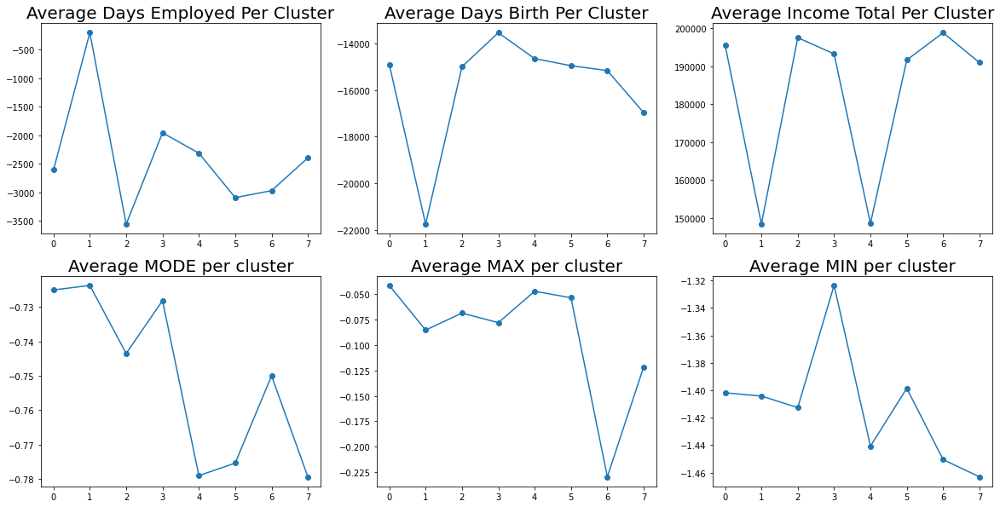

In [ ]:
plt.figure(figsize = (20,10))

plt.subplot(2,3,1)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.DAYS_EMPLOYED, 'o-')
plt.title('Average Days Employed Per Cluster', fontsize=20)

plt.subplot(2,3,2)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.DAYS_BIRTH, 'o-')
plt.title('Average Days Birth Per Cluster', fontsize=20)

plt.subplot(2,3,3)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.AMT_INCOME_TOTAL, 'o-')
plt.title('Average Income Total Per Cluster', fontsize=20)

plt.subplot(2,3,4)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.MODE, 'o-')
plt.title('Average MODE per cluster', fontsize=20)

plt.subplot(2,3,5)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.MAX, 'o-')
plt.title('Average MAX per cluster', fontsize=20)

plt.subplot(2,3,6)
plt.plot(mean_per_cluster.cluster_labels_2, mean_per_cluster.MIN, 'o-')
plt.title('Average MIN per cluster', fontsize=20)



In [ ]:
max_per_cluster = application_data_clusters_agg_8.groupby(['cluster_labels']).max()
max_per_cluster

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels_2
cluster_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5150487,5,0,5,1575000.0,-7705.0,-200.0,1.0,1.0,1.0,20.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0
1,5150423,5,0,1,675000.0,-8145.0,-200.0,1.0,1.0,1.0,5.0,1,1,1,1,0,1,1,0,0,1,1,1,0,1,1,0,0,0,0,1
2,5150118,3,0,1,716323.5,-8100.0,-200.0,1.0,1.0,1.0,6.0,1,1,1,1,0,1,1,0,1,1,1,1,1,1,1,0,0,0,1,2
3,5150429,3,1,1,900000.0,-7723.0,-200.0,1.0,1.0,1.0,4.0,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,0,1,3
4,5150468,5,0,1,495000.0,-8069.0,-200.0,1.0,1.0,1.0,5.0,1,1,1,1,1,1,0,1,1,1,1,1,0,0,0,0,1,0,0,4
5,5149951,5,0,0,540000.0,-8098.0,-200.0,1.0,1.0,1.0,6.0,1,1,1,1,1,1,0,1,1,1,1,1,0,0,0,1,0,0,0,5
6,5149266,2,0,0,423000.0,-7489.0,-200.0,1.0,1.0,1.0,4.0,1,1,1,1,1,1,0,1,1,1,1,1,0,0,0,0,0,1,0,6
7,5150286,3,0,2,742500.0,-8274.0,-200.0,1.0,1.0,1.0,6.0,1,1,1,0,1,0,1,1,1,1,1,1,1,1,1,0,0,0,1,7


In [ ]:
min_per_cluster = application_data_clusters_agg_8.groupby(['cluster_labels']).min()
min_per_cluster

,ID,MAX,MIN,MODE,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Gender_M,Own_Car_Y,Own_Realty_Y,Family_Status_Married,Family_Status_Separated,Family_Status_Single / not married,Income_Type_Retired,Income_Type_Working Private,Income_Type_Working Public,Housing_Type_House / apartment,Education_Type_Higher education,Education_Type_Secondary / secondary special,Occupation_Type_Core staff,Occupation_Type_General Laborer,Occupation_Type_High Skill Jobs,Occupation_Type_High skill tech staff,Occupation_Type_Hospitality Service,Occupation_Type_Private service staff,Occupation_Type_Sales staff,cluster_labels_2
cluster_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5008804,-2,-2,-2,27000.0,-24611.0,-15713.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,5008827,-2,-2,-2,29250.0,-25152.0,-2208.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
2,5008868,-2,-2,-2,32400.0,-23599.0,-15227.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2
3,5008808,-2,-2,-2,45000.0,-24611.0,-9581.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3
4,5009424,-2,-2,-2,40500.0,-23395.0,-11451.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4
5,5008942,-2,-2,-2,54000.0,-24339.0,-14775.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,5
6,5009058,-2,-2,-2,72000.0,-24204.0,-11157.0,0.0,0.0,0.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,6
7,5008812,-2,-2,-2,36000.0,-24970.0,-15072.0,0.0,0.0,0.0,1.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7


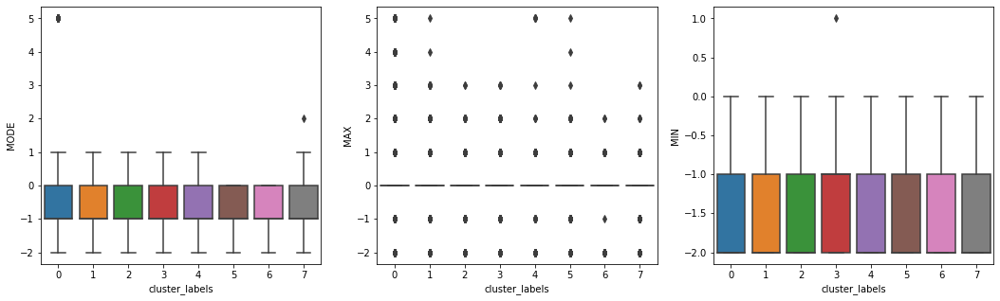

In [ ]:
plt.figure(figsize=(18,5))

plt.subplot(1,3,1)
ax = sns.boxplot(y='MODE', x = 'cluster_labels', data=application_data_clusters_agg_8)
ax.set_xticklabels(ax.get_xticklabels());

plt.subplot(1,3,2)
ax = sns.boxplot(y='MAX', x = 'cluster_labels', data=application_data_clusters_agg_8)
ax.set_xticklabels(ax.get_xticklabels());

plt.subplot(1,3,3)
ax = sns.boxplot(y='MIN', x = 'cluster_labels', data=application_data_clusters_agg_8)
ax.set_xticklabels(ax.get_xticklabels());



The MODE values seem to be very similar across the different clusters created. with some outliers in cluster 1 and 7 towards high values of MODE which means there are some high risk customer on those groups but they represent mainly outliers. The lowest risk cluster seems to be cluster number 6

Evaluation for clusters in DBSCAN (eps=7):


In [ ]:
application_data_clusters_dbscan_7 = application_total_filtered.copy()

In [ ]:
application_data_clusters_dbscan_7['cluster_labels'] = clusters_dbscan_7

In [ ]:
application_data_clusters_dbscan_7

,ID,MAX,MIN,MODE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,cluster_labels
3231,5008804,1,-2,-1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005.0,-4542.0,1.0,1.0,0.0,0.0,Unknown,2.0,0
3232,5008805,1,-2,-1,M,Y,Y,0.0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005.0,-4542.0,1.0,1.0,0.0,0.0,Unknown,2.0,0
3233,5008806,0,-2,-2,M,Y,Y,0.0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474.0,-1134.0,1.0,0.0,0.0,0.0,Security staff,2.0,0
3234,5008808,0,-2,-2,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,0
3235,5008809,-2,-2,-2,F,N,Y,0.0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110.0,-3051.0,1.0,0.0,1.0,1.0,Sales staff,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0,0
45981,5150483,-2,-2,-2,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0,0
45982,5150484,0,-1,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0,0
45983,5150485,0,0,0,F,Y,Y,1.0,157500.0,Working,Secondary / secondary special,Married,House / apartment,-10808.0,-1739.0,1.0,0.0,0.0,0.0,Core staff,3.0,0


In [ ]:
application_data_clusters_dbscan_7['cluster_labels'].unique()

array([ 0,  1, -1])

In [ ]:
application_data_clusters_dbscan_7[application_data_clusters_dbscan_7.cluster_labels == 0].describe()

,ID,MAX,MIN,MODE,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,cluster_labels
count,3.610800e+04,36108.000000,36108.000000,36108.000000,36108.000000,3.610800e+04,36108.000000,36108.000000,36108.0,36108.000000,36108.000000,36108.000000,36108.000000,36108.0
mean,5.078169e+06,-0.058574,-1.400050,-0.732691,0.428298,1.865607e+05,-15983.049435,-2228.899247,1.0,0.225573,0.294339,0.089205,2.198156,0.0
std,4.185239e+04,0.831484,0.719046,0.783232,0.726462,1.019513e+05,4208.357588,2333.653731,0.0,0.417965,0.455751,0.285043,0.899639,0.0
min,5.008804e+06,-2.000000,-2.000000,-2.000000,0.000000,2.700000e+04,-25152.000000,-15713.000000,1.0,0.000000,0.000000,0.000000,1.000000,0.0
25%,5.042012e+06,0.000000,-2.000000,-1.000000,0.000000,1.215000e+05,-19452.000000,-3149.000000,1.0,0.000000,0.000000,0.000000,2.000000,0.0
50%,5.074618e+06,0.000000,-2.000000,-1.000000,0.000000,1.575000e+05,-15567.000000,-1539.000000,1.0,0.000000,0.000000,0.000000,2.000000,0.0
75%,5.114628e+06,0.000000,-1.000000,0.000000,1.000000,2.250000e+05,-12454.000000,-401.000000,1.0,0.000000,1.000000,0.000000,3.000000,0.0
max,5.150487e+06,5.000000,1.000000,5.000000,7.000000,1.575000e+06,-7705.000000,-200.000000,1.0,1.000000,1.000000,1.000000,9.000000,0.0


In [ ]:
application_data_clusters_dbscan_7[application_data_clusters_dbscan_7.cluster_labels == 1].describe()

,ID,MAX,MIN,MODE,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,cluster_labels
count,3.440000e+02,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.000000,344.0,344.000000,344.000000,344.000000,344.000000,344.0
mean,5.084498e+06,-0.229651,-1.450581,-0.750000,0.468023,198863.372093,-15167.793605,-2968.686047,1.0,0.220930,0.345930,0.142442,2.063953,1.0
std,4.395132e+04,0.791459,0.722725,0.809023,0.633488,81533.714404,3184.003161,2366.300773,0.0,0.415478,0.476363,0.350012,0.874973,0.0
min,5.009058e+06,-2.000000,-2.000000,-2.000000,0.000000,72000.000000,-24204.000000,-11157.000000,1.0,0.000000,0.000000,0.000000,1.000000,1.0
25%,5.048399e+06,0.000000,-2.000000,-1.000000,0.000000,135000.000000,-17538.000000,-3390.000000,1.0,0.000000,0.000000,0.000000,1.000000,1.0
50%,5.068782e+06,0.000000,-2.000000,-1.000000,0.000000,180000.000000,-14320.500000,-2775.000000,1.0,0.000000,0.000000,0.000000,2.000000,1.0
75%,5.135913e+06,0.000000,-1.000000,0.000000,1.000000,225000.000000,-13136.750000,-1409.750000,1.0,0.000000,1.000000,0.000000,3.000000,1.0
max,5.149266e+06,2.000000,0.000000,0.000000,2.000000,423000.000000,-7489.000000,-200.000000,1.0,1.000000,1.000000,1.000000,4.000000,1.0


Seems like DBSCAN is making a big cluster with the data to achieve the high Silhoutte Score. Therefore, despite the highest Silhouette Score, the selected metod would be the Hierarchical Clustering Techniques.

# Analyzing the Clusters

Hierarchical Clustering Technique clusters are evaluated below:

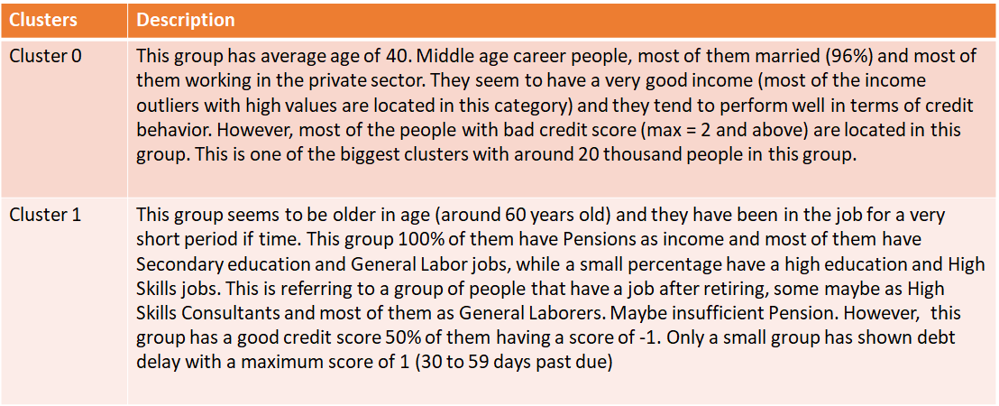

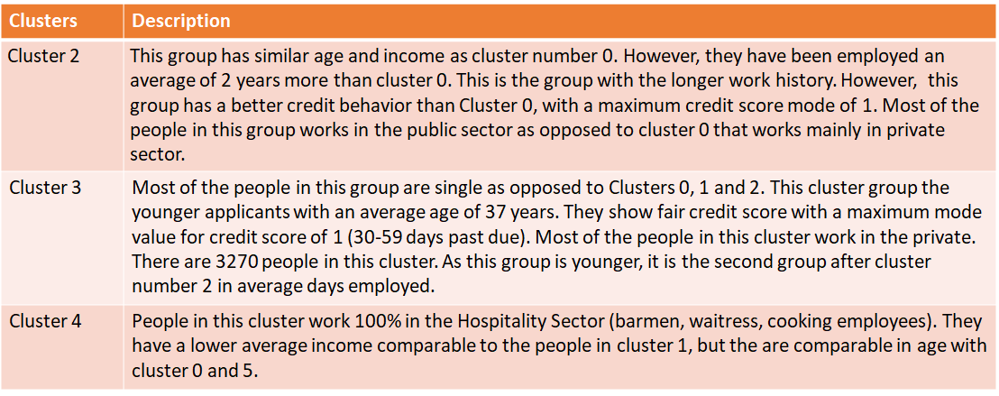

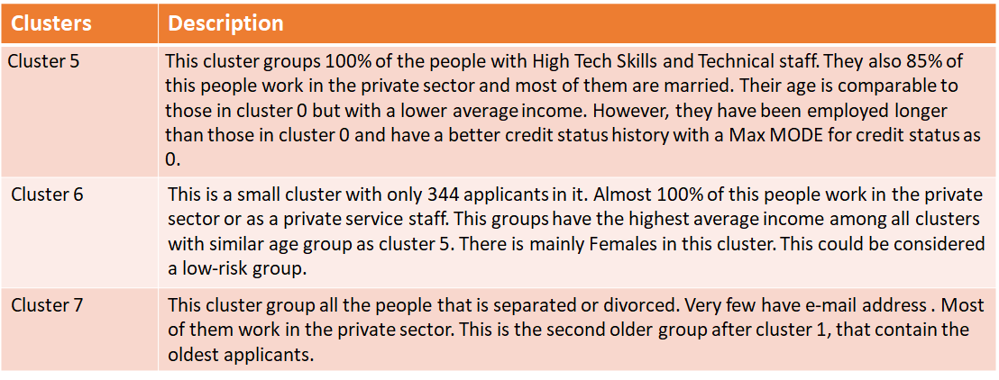

# Conclusions

- Hierarchical clustering technique with 8 clusters and Ward as Linkage method generates the best clusters was selected as the final clustering technique in this Capstone.
- Even though DBSCAN generated the highest Silhouette score was not the selected method because it only generates a big cluster and another small one, probably because the data points being so close together as shown in the visualization.
- Each group/cluster is different from each other at some level. Evaluation of the clusters can provide insight on what group/cluster can be labeled as high risk when issuing a credit card.
- Status data (MODE) and average status data is very similar among groups, with few outliers towards bad credit in groups 0 and 7.
- Reduction in the number of features/dimensions on the data generates an increase in Silhouette Score value and a better visualization of the clusters.
- PCA provides a better dimensionality reduction visualization in this case than UMAP.

# Recommendations

- Clusters could benefit for additional feature engineering and dimensionality reduction techniques to improve Silhouette Score values.
- Application forms could be prepared with specific yes or no categories, in order to avoid to many different categories per feature. This happens because the open questions.